In [1]:
import numpy as np

In [2]:
import networkx as nx
import matplotlib as mpl
mpl.rcParams['figure.dpi'] = 300
import matplotlib.pyplot as plt


In [3]:
precomputed_graph = np.load('precomputed_graph_20nn.npy')

In [220]:
nx.find_cycle(graph, source=150)

[(150, 7),
 (7, 518),
 (518, 229),
 (229, 39),
 (39, 42),
 (42, 299),
 (299, 27),
 (27, 150)]

In [4]:
graph = nx.convert_matrix.from_numpy_array(precomputed_graph)
G = nx.minimum_spanning_tree(graph, weight='weight')

In [5]:
highest_degree = sorted(list(G.degree()), key = lambda x: int(x[1]), reverse=True)[:1]

In [16]:
graph.edges[150, 7]['weight']

0.9800000190734863

In [81]:
from copy import deepcopy
circles = []
circles_weight = []



# for i in range(len(precomputed_graph)):
i = highest_degree[0][0]
edge_list_bfs = list(nx.dfs_edges(graph, source=i, depth_limit=len(precomputed_graph)))
edge_long_list = []
key = i
# first_key = i
# graph[edge[0], edge[1]]['weight']
for edge in edge_list_bfs:
    if edge[0] == key:
        edge_long_list.append([edge[0], edge[1]])
    else:
        new_append = None
        for edge_list in edge_long_list:
            if edge[0] == edge_list[-1] and edge[1] not in edge_list:
                new_append = deepcopy(edge_list)
                break
#             elif edge[0] == edge_list[-1] and edge[1] in edge_list:
#                 edge_list.append(edge[1])
#                 circles.append(edge_list)
        if new_append is not None:
            new_append.append(edge[1])
            edge_long_list.append(new_append)

for found_paths in edge_long_list:
    if found_paths[-1] in graph[key]:
#         found_paths.append(key)
        weight = 0
        i = 0
        while i < len(found_paths) - 1:
            weight += graph.edges[found_paths[i], found_paths[i + 1]]['weight']
            i += 1
        weight += graph.edges[found_paths[-1], key]['weight']
        weight /= (len(found_paths)+1)
        if len(found_paths) > len(precomputed_graph) * 0.66:
            circles_weight.append(weight)
            circles.append(found_paths)

2325

In [76]:
max_path = circles[np.argmin(circles_weight)]

In [50]:
non_cycle = list(range(len(precomputed_graph)))
for node in max_path:
    if node in non_cycle:
        non_cycle.remove(node)
 

In [67]:
indices

array([[1680, 2290]])

In [82]:
from sklearn.neighbors import NearestNeighbors
nbrs = NearestNeighbors(n_neighbors=10, algorithm='ball_tree').fit(precomputed_graph)
non_inserted = []
for node in non_cycle:
    distances, indices = nbrs.kneighbors([precomputed_graph[node]])
    count = 0
    for neighbor in indices[0]:
        if neighbor in max_path:
#             max_path.index(neighbor)
            max_path.insert(max_path.index(neighbor)+1, node)
            break
        else:
            count += 1
    if count == 5:
        non_inserted.append(node)

In [83]:
non_inserted

[]

In [65]:
max_path.index(indices[0][1])
max_path.insert(max_path.index(indices[0][1]), non_cycle[0])

In [71]:
max_path[max_path.index(indices[0][1])-2:max_path.index(indices[0][1])+2]

[1670, 1680, 2290, 2467]

In [296]:
import collections
print([item for item, count in collections.Counter(max_path).items() if count > 1])

[150]


In [275]:
for edge_list in edge_long_list:
    if 299 == edge_list[-2]:
        print(edge_list)
    

In [44]:
count = 0
for node in G.degree():
    if node[1] == 1:
        count += 1
count 

2007

In [159]:
longest_cycle_path = []
max_length = 0
for i in range(len(precomputed_graph)):
    try:
        cycle_path = nx.find_cycle(graph, source=i)
    except:
        continue
    if max_length < len(cycle_path):
        longest_cycle_path = cycle_path
        max_length = len(cycle_path)

In [161]:
longest_cycle_path

[(39, 174),
 (174, 46),
 (46, 165),
 (165, 78),
 (78, 198),
 (198, 69),
 (69, 224),
 (224, 31),
 (31, 355),
 (355, 221),
 (221, 71),
 (71, 82),
 (82, 53),
 (53, 59),
 (59, 32),
 (32, 23),
 (23, 139),
 (139, 28),
 (28, 127),
 (127, 89),
 (89, 86),
 (86, 3),
 (3, 572),
 (572, 22),
 (22, 8),
 (8, 36),
 (36, 191),
 (191, 1),
 (1, 235),
 (235, 130),
 (130, 60),
 (60, 150),
 (150, 7),
 (7, 518),
 (518, 229),
 (229, 39)]

In [167]:
node_color = ['b'] * len(precomputed_graph)
node_size = [1] * len(precomputed_graph)

for edge in longest_cycle_path:
    node_color[edge[0]] = 'r'
    node_size[edge[0]] = 50

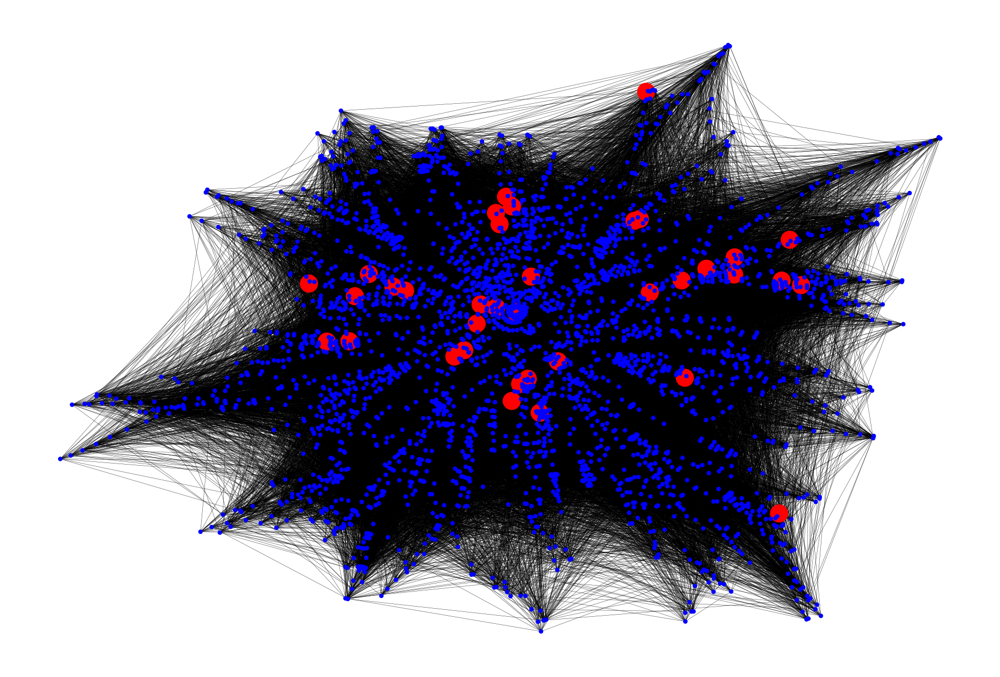

In [170]:
pos = nx.spring_layout(G, iterations=150)
nx.draw(graph, pos, node_size=node_size, node_color = node_color, width=0.1, edge_with_labels=False)
plt.show()

In [18]:
len(precomputed_graph[0])

3494

In [102]:
G = nx.minimum_spanning_tree(graph, weight='weight')

In [103]:
node_size_all = np.ones(len(precomputed_graph[0]))
node_color_all = ['b'] * len(precomputed_graph[0])
highest_degree = sorted(list(G.degree()), key = lambda x: int(x[1]), reverse=True)[:7]
for index, value in highest_degree:
    node_size_all[index] = value
    node_color_all[index] = 'g'

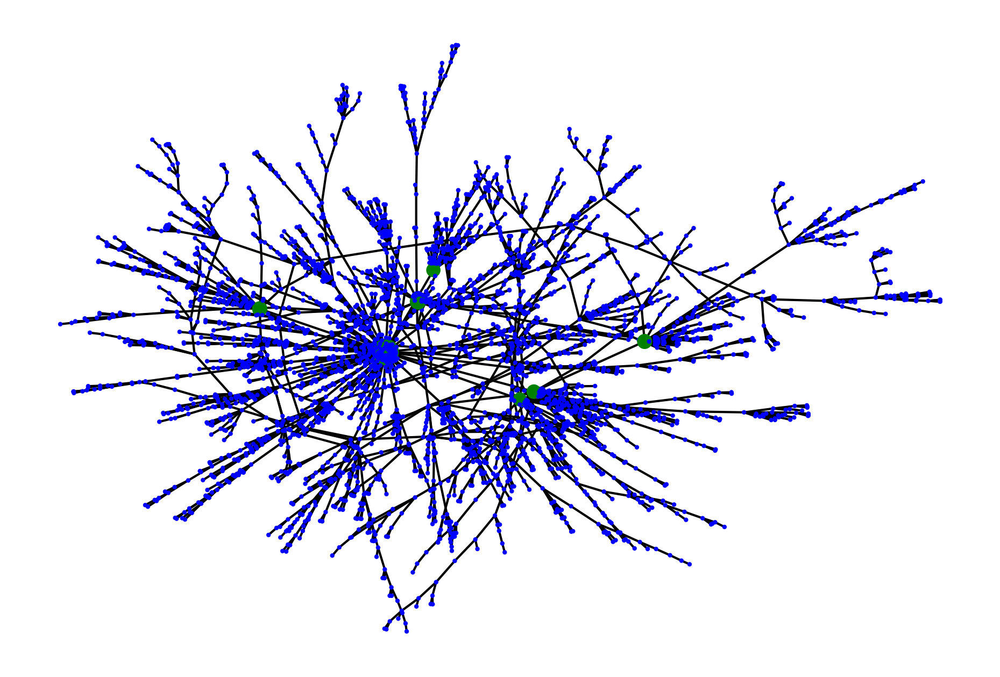

In [104]:
pos = nx.spring_layout(G, iterations=150)
nx.draw(G, pos, node_size=node_size_all, node_color=node_color_all, with_labels=False)
plt.show()
# find a cut of n-edges that separates the graph in k-subgraphs
# and each subgraph has a minimal distance within itself

In [110]:
all_pairs = nx.single_source_dijkstra_path(G, 0)

In [118]:
new_graph = nx.Graph()
for key, value in all_pairs.items():
    i = 0
    while i < len(value)-1:
        
        if key != value[i]:
            if i == 0:
                new_graph.add_edge(key, value[i])
            else:
                new_graph.add_edge(value[i], value[i+1])
        i += 1
    

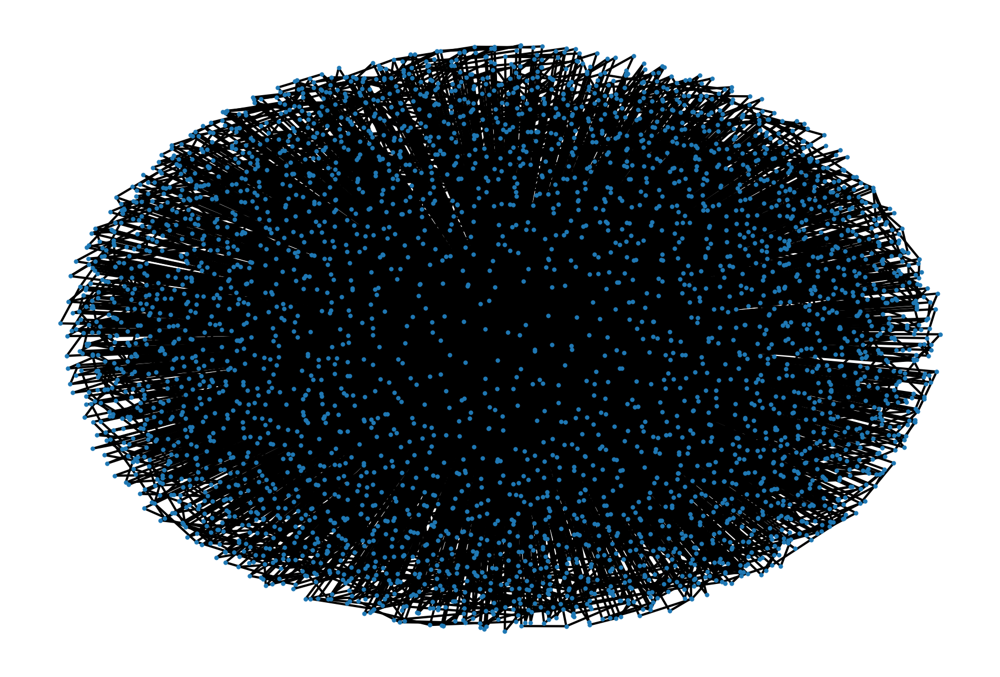

In [120]:
pos = nx.spring_layout(new_graph, iterations=150)
nx.draw(new_graph, pos, node_size=1, with_labels=False)
plt.show()

In [125]:
nx.degree(new_graph)

SyntaxError: invalid syntax (<ipython-input-125-a6ae0a231ea8>, line 1)

In [39]:
highest_degree = sorted(list(G.degree()), key = lambda x: int(x[1]), reverse=True)[:7]
lowest_degree = sorted(list(G.degree()), key = lambda x: int(x[1]), reverse=False)
one_degree = []
# one_degree = [one_degree_node if one_degree_node[1] == 1 for one_degree_node in lowest_degree]
for index, value in lowest_degree:
    if value == 1:
        one_degree.append((index, value))
    else:
        break
clusters = {}
for index, value in highest_degree:
    for index_one_degree, value_one_degree in one_degree:
        shortest_path = nx.shortest_path(G, source=index, target=index_one_degree)
        count = 0
        for index_inner, value_inner in highest_degree:
            if index_inner != index and index_inner in shortest_path:
                count += 1
        if count == 0:  
            if index in clusters:
                clusters[index].append(shortest_path)
            else:
                clusters[index] = [shortest_path]

In [15]:
for key in clusters.keys():
    print(len(clusters[key]))

734
82
109
52
735
134
223


In [28]:
for key in clusters.keys():
    clusters[key] = [item for sublist in clusters[key] for item in sublist]
    clusters[key] = np.unique(clusters[key])

In [30]:
clusters.keys()

dict_keys([150, 1130, 989, 728, 1376, 1902, 521])

In [34]:
print(len(np.setdiff1d(clusters[1130], clusters[989])))
print(len(np.setdiff1d(clusters[989], clusters[1130])))
print(len(np.setdiff1d(clusters[1130], clusters[728])))
print(len(clusters[1130]))

131
192
131
131


In [40]:
clusters_tmp = {}
for key in clusters.keys():
    for key_intern in clusters.keys():
        if key != key_intern:
            if key in clusters_tmp:
                clusters_tmp[key].append(nx.shortest_path(G, source=key, target=key_intern))
            else:
                clusters_tmp[key] = [nx.shortest_path(G, source=key, target=key_intern)]
                

In [41]:
clusters_tmp

{150: [[150, 1130],
  [150, 989],
  [150, 989, 728],
  [150, 1376],
  [150, 1902],
  [150, 2757, 521]],
 1130: [[1130, 150],
  [1130, 150, 989],
  [1130, 150, 989, 728],
  [1130, 150, 1376],
  [1130, 150, 1902],
  [1130, 150, 2757, 521]],
 989: [[989, 150],
  [989, 150, 1130],
  [989, 728],
  [989, 150, 1376],
  [989, 150, 1902],
  [989, 150, 2757, 521]],
 728: [[728, 989, 150],
  [728, 989, 150, 1130],
  [728, 989],
  [728, 989, 150, 1376],
  [728, 989, 150, 1902],
  [728, 989, 150, 2757, 521]],
 1376: [[1376, 150],
  [1376, 150, 1130],
  [1376, 150, 989],
  [1376, 150, 989, 728],
  [1376, 150, 1902],
  [1376, 150, 2757, 521]],
 1902: [[1902, 150],
  [1902, 150, 1130],
  [1902, 150, 989],
  [1902, 150, 989, 728],
  [1902, 150, 1376],
  [1902, 150, 2757, 521]],
 521: [[521, 2757, 150],
  [521, 2757, 150, 1130],
  [521, 2757, 150, 989],
  [521, 2757, 150, 989, 728],
  [521, 2757, 150, 1376],
  [521, 2757, 150, 1902]]}

In [26]:
for key in clusters_tmp.keys():
    print(len(clusters_tmp[key]))

1050
131
192
103
1350
257
411


In [36]:
for key in clusters.keys():
    for value in clusters[key][1:]:
        try:
            G.remove_node(value)
        except Exception:
            continue

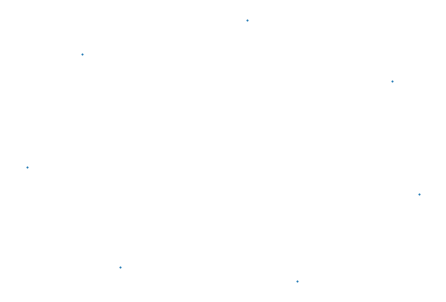

In [37]:
pos = nx.spring_layout(G, iterations=300)
nx.draw(G, pos, node_size=1, with_labels=False)
plt.show()

In [76]:

from collections import defaultdict

import matplotlib.pyplot as plt
import networkx as nx
import numpy
from scipy.cluster import hierarchy
from scipy.spatial import distance


def create_hc(G):
    """Creates hierarchical cluster of graph G from distance matrix"""
    path_length = nx.all_pairs_dijkstra_path(G)
    distances = numpy.zeros((len(G), len(G)))
    for u, p in path_length:
        for v, d in p.items():
            print(d)
            distances[u][v] = d[0]
    # Create hierarchical cluster
#     Y = distance.squareform(distances)
    Z = hierarchy.complete(Y)  # Creates HC using farthest point linkage
    # This partition selection is arbitrary, for illustrive purposes
    membership = list(hierarchy.fcluster(Z, t=1.15))
    # Create collection of lists for blockmodel
    partition = defaultdict(list)
    for n, p in zip(list(range(len(G))), membership):
        partition[p].append(n)
    return list(partition.values())



# G = nx.read_edgelist("hartford_drug.edgelist")

# Extract largest connected component into graph H
H = G.subgraph(next(nx.connected_components(G)))
# Makes life easier to have consecutively labeled integer nodes
H = nx.convert_node_labels_to_integers(H)
# Create parititions with hierarchical clustering
partitions = create_hc(H)
# Build blockmodel graph
BM = nx.quotient_graph(H, partitions, relabel=True)

# Draw original graph
pos = nx.spring_layout(H, iterations=150)
# plt.subplot(211)
nx.draw(H, pos, with_labels=False, node_size=1)
plt.show()
plt.close()
# Draw block model with weighted edges and nodes sized by number of internal nodes
node_size = [BM.nodes[x]['nnodes'] * 2 for x in BM.nodes()]
edge_width = [(2 * d['weight']) for (u, v, d) in BM.edges(data=True)]
# Set positions to mean of positions of internal nodes from original graph
posBM = {}
for n in BM:
    xy = numpy.array([pos[u] for u in BM.nodes[n]['graph']])
    posBM[n] = xy.mean(axis=0)

nx.draw(BM, posBM, node_size=node_size, width=edge_width, with_labels=False)
plt.axis('off')
plt.show()

[0]
[0, 3165]
[0, 989]
[0, 989, 88]
[0, 989, 103]
[0, 989, 150]
[0, 989, 263]
[0, 989, 569]
[0, 989, 643]
[0, 989, 705]
[0, 989, 728]
[0, 989, 857]
[0, 989, 941]
[0, 989, 975]
[0, 989, 1646]
[0, 989, 1596]
[0, 989, 2408]
[0, 989, 3374]
[0, 989, 3480]
[0, 989, 1479]
[0, 989, 1912]
[0, 989, 3389]
[0, 989, 2029]
[0, 989, 2692]
[0, 989, 2482]
[0, 989, 2752]
[0, 989, 2787]
[0, 989, 150, 16]
[0, 989, 150, 113]
[0, 989, 150, 126]
[0, 989, 150, 1376]
[0, 989, 150, 2757]
[0, 989, 150, 1902]
[0, 989, 150, 1808]
[0, 989, 150, 2334]
[0, 989, 150, 3447]
[0, 989, 150, 1130]
[0, 989, 150, 2200]
[0, 989, 150, 1423]
[0, 989, 150, 681]
[0, 989, 150, 1397]
[0, 989, 150, 3103]
[0, 989, 150, 3140]
[0, 989, 150, 3456]
[0, 989, 150, 1379]
[0, 989, 150, 1266]
[0, 989, 150, 345]
[0, 989, 150, 851]
[0, 989, 150, 924]
[0, 989, 150, 1196]
[0, 989, 150, 1893]
[0, 989, 150, 2167]
[0, 989, 150, 2252]
[0, 989, 150, 2358]
[0, 989, 150, 2598]
[0, 989, 150, 2646]
[0, 989, 150, 293]
[0, 989, 150, 589]
[0, 989, 150, 627]


[0, 989, 150, 1376, 1117, 830, 1417, 1220, 1358, 3403, 741, 168, 327, 94, 3309, 737, 3470, 2903, 2417, 3254, 2995, 1188, 1747, 2164]
[0, 989, 150, 1376, 1117, 830, 1417, 1220, 1358, 3403, 741, 168, 327, 94, 3309, 737, 3470, 2903, 1351, 769, 1282, 750, 2387, 659]
[0, 989, 150, 1376, 1117, 830, 1417, 1220, 1358, 3403, 741, 168, 327, 94, 3309, 737, 3470, 2903, 2417, 1173, 1033, 2043, 2019, 2913]
[0, 989, 150, 1376, 1117, 830, 1417, 1220, 1358, 3403, 741, 168, 327, 94, 3309, 737, 3470, 2903, 2417, 1173, 1033, 406, 1941, 3422]
[0, 989, 150, 1376, 1117, 830, 1417, 1220, 1358, 3403, 741, 168, 327, 94, 3309, 737, 3470, 2903, 2417, 1173, 1033, 406, 17, 3259]
[0, 989, 150, 1376, 1117, 830, 1417, 1220, 1358, 3403, 741, 168, 327, 94, 3309, 737, 3470, 2903, 2417, 695, 531, 450, 1593, 1140]
[0, 989, 150, 1376, 1117, 830, 1417, 1220, 1358, 3403, 741, 168, 327, 94, 3309, 737, 3470, 2903, 2417, 695, 531, 450, 1593, 2146]
[0, 989, 150, 1376, 1117, 830, 1417, 1220, 1358, 3403, 741, 168, 327, 94, 3309, 73

[1, 612, 1946, 566, 1808, 150, 1130, 2025, 2619, 2657]
[1, 612, 1946, 566, 1808, 1853, 1922, 61, 262, 2574]
[1, 612, 1946, 566, 1808, 150, 1130, 1471, 1142, 1550]
[1, 612, 1946, 566, 1808, 150, 1423, 2233, 424, 1102]
[1, 612, 1946, 566, 1808, 150, 1423, 2233, 424, 1603]
[1, 612, 1946, 566, 1808, 1853, 1922, 61, 173, 1755]
[1, 612, 1946, 566, 1808, 150, 1130, 546, 1090, 1854]
[1, 612, 1946, 566, 1808, 1853, 1922, 699, 1081, 3218]
[1, 612, 1946, 566, 1808, 1853, 1922, 875, 2492, 1333]
[1, 612, 1946, 566, 1808, 150, 1423, 72, 396, 2883]
[1, 612, 1946, 566, 1808, 150, 1423, 72, 895, 2953]
[1, 612, 1946, 566, 1808, 150, 1423, 72, 1175, 909]
[1, 612, 1946, 566, 1808, 150, 1423, 72, 1175, 3154]
[1, 612, 1946, 566, 1808, 150, 1423, 72, 1290, 1614]
[1, 612, 1946, 566, 1808, 150, 1423, 856, 234, 2797]
[1, 612, 1946, 566, 1808, 150, 1423, 923, 10, 2001]
[1, 612, 1946, 566, 1808, 150, 1423, 923, 10, 3172]
[1, 612, 1946, 566, 1808, 1853, 1922, 2254, 344, 3235]
[1, 612, 1946, 566, 1808, 1853, 1922, 

[1, 612, 1946, 566, 1808, 150, 1376, 1117, 830, 1417, 1220, 1358, 3403, 741, 168, 327, 94, 3309, 737, 3470, 2903, 2417, 1548, 43, 2819, 782, 1067, 2380]
[1, 612, 1946, 566, 1808, 150, 1376, 1117, 830, 1417, 1220, 1358, 3403, 741, 168, 327, 94, 3309, 737, 3470, 2903, 2417, 1548, 43, 2819, 782, 1906, 1765]
[1, 612, 1946, 566, 1808, 150, 1376, 1117, 830, 1417, 1220, 1358, 3403, 741, 168, 327, 94, 3309, 737, 3470, 2903, 2417, 1548, 43, 2819, 782, 2822, 3009]
[1, 612, 1946, 566, 1808, 150, 1376, 1117, 830, 1417, 1220, 1358, 3403, 741, 168, 327, 94, 3309, 737, 3470, 2105, 1589, 771, 2606, 2820, 419, 1058, 1331]
[1, 612, 1946, 566, 1808, 150, 1376, 1117, 830, 1417, 1220, 1358, 3403, 741, 168, 327, 94, 3309, 737, 3470, 2105, 1589, 771, 2606, 2820, 419, 1553, 1873]
[1, 612, 1946, 566, 1808, 150, 1376, 1117, 830, 1417, 1220, 1358, 3403, 741, 168, 327, 94, 3309, 737, 3470, 2903, 2417, 3254, 2995, 638, 2767, 692, 1949, 714]
[1, 612, 1946, 566, 1808, 150, 1376, 1117, 830, 1417, 1220, 1358, 3403, 74

[2, 623, 120, 2027, 211, 2417, 2903, 1351, 769, 3241, 430, 432, 3382, 509, 271, 466, 3404, 632, 1231, 1189, 1433, 2469, 795, 3109]
[2, 623, 120, 2027, 211, 2417, 2903, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 1723, 995, 799]
[2, 623, 120, 2027, 211, 2417, 2903, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 1723, 995, 1361]
[2, 623, 120, 2027, 211, 2417, 2903, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 1723, 995, 1926]
[2, 623, 120, 2027, 211, 2417, 2903, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 1723, 931, 2782]
[2, 623, 120, 2027, 211, 2417, 2903, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 1723, 931, 1206]
[2, 623, 120, 2027, 211, 2417, 2903, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 2806, 867, 1530]
[2, 623, 120, 2027, 211, 2417, 2903, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358,

[3]
[3, 2203]
[3, 2203, 1718]
[3, 2203, 2558]
[3, 2203, 2525]
[3, 2203, 1718, 38]
[3, 2203, 1718, 204]
[3, 2203, 1718, 378]
[3, 2203, 1718, 527]
[3, 2203, 1718, 815]
[3, 2203, 1718, 1254]
[3, 2203, 1718, 1376]
[3, 2203, 1718, 1621]
[3, 2203, 1718, 2927]
[3, 2203, 1718, 2630]
[3, 2203, 1718, 1815]
[3, 2203, 1718, 2735]
[3, 2203, 1718, 3141]
[3, 2203, 2558, 1757]
[3, 2203, 1718, 1376, 48]
[3, 2203, 1718, 1376, 150]
[3, 2203, 1718, 1376, 702]
[3, 2203, 1718, 1376, 726]
[3, 2203, 1718, 1376, 866]
[3, 2203, 1718, 1376, 947]
[3, 2203, 1718, 1376, 981]
[3, 2203, 1718, 1376, 1009]
[3, 2203, 1718, 1376, 1026]
[3, 2203, 1718, 1376, 1117]
[3, 2203, 1718, 1376, 1183]
[3, 2203, 1718, 1376, 1258]
[3, 2203, 1718, 1376, 1354]
[3, 2203, 1718, 1376, 1723]
[3, 2203, 1718, 1376, 2806]
[3, 2203, 1718, 1376, 2139]
[3, 2203, 1718, 1376, 2262]
[3, 2203, 1718, 1376, 2243]
[3, 2203, 1718, 1376, 1578]
[3, 2203, 1718, 1376, 2006]
[3, 2203, 1718, 1376, 3296]
[3, 2203, 1718, 1376, 2572]
[3, 2203, 1718, 2927, 55]
[3

[3, 2203, 1718, 1376, 866, 1158, 1870, 1380, 553, 2705]
[3, 2203, 1718, 527, 143, 1999, 983, 1737, 2557, 3436]
[3, 2203, 1718, 1376, 150, 1808, 1853, 1922, 3013, 1457, 1048]
[3, 2203, 1718, 1376, 150, 1808, 1853, 1922, 3013, 679, 1890]
[3, 2203, 1718, 1376, 150, 1808, 1853, 1922, 3013, 679, 2627]
[3, 2203, 1718, 1376, 150, 1808, 1853, 1922, 3013, 2137, 2690]
[3, 2203, 1718, 1376, 150, 1808, 1853, 1922, 3013, 40, 906]
[3, 2203, 1718, 1376, 150, 1808, 1853, 1922, 3013, 1710, 1288]
[3, 2203, 1718, 1376, 150, 1808, 1853, 1922, 3013, 1710, 1366]
[3, 2203, 1718, 1376, 150, 1808, 1853, 1922, 3013, 1710, 1972]
[3, 2203, 1718, 1376, 150, 1808, 1853, 1922, 3013, 1710, 2076]
[3, 2203, 1718, 1376, 150, 1808, 1853, 1922, 3013, 1710, 2123]
[3, 2203, 1718, 1376, 150, 2757, 1536, 1696, 1618, 1096, 81]
[3, 2203, 1718, 1376, 150, 2757, 1536, 1696, 1618, 1679, 1151]
[3, 2203, 1718, 1376, 150, 2757, 1536, 1696, 1618, 1679, 1459]
[3, 2203, 1718, 1376, 150, 2757, 1536, 1696, 1618, 1679, 1849]
[3, 2203, 1718

[4, 1231, 632, 3404, 466, 271, 509, 3382, 432, 430, 3241, 769, 1351, 2903, 2417, 211, 2889, 753, 3079]
[4, 1231, 632, 3404, 466, 271, 509, 3382, 432, 430, 3241, 769, 1351, 2903, 3470, 737, 2003, 175, 1594]
[4, 1231, 632, 3404, 466, 271, 509, 3382, 432, 430, 3241, 769, 1351, 2903, 3470, 737, 2003, 175, 3008]
[4, 1231, 632, 3404, 466, 271, 509, 3382, 432, 430, 3241, 769, 1351, 2903, 3470, 737, 2003, 175, 3398]
[4, 1231, 632, 3404, 466, 271, 509, 3382, 432, 430, 3241, 769, 1351, 2903, 3470, 737, 2003, 175, 470]
[4, 1231, 632, 3404, 466, 271, 509, 3382, 432, 430, 3241, 769, 1351, 2903, 3470, 737, 2003, 175, 3043]
[4, 1231, 632, 3404, 466, 271, 509, 3382, 432, 430, 3241, 769, 1351, 2903, 3470, 1841, 85, 265, 758]
[4, 1231, 632, 3404, 466, 271, 509, 3382, 432, 430, 3241, 769, 1351, 2903, 3470, 1841, 85, 265, 624]
[4, 1231, 632, 3404, 466, 271, 509, 3382, 432, 430, 3241, 769, 1351, 2903, 3470, 1841, 85, 265, 1064]
[4, 1231, 632, 3404, 466, 271, 509, 3382, 432, 430, 3241, 769, 1351, 2903, 3470

[4, 1231, 632, 3404, 466, 271, 509, 3382, 432, 430, 3241, 769, 1351, 2903, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 1423, 72, 1290, 1614]
[4, 1231, 632, 3404, 466, 271, 509, 3382, 432, 430, 3241, 769, 1351, 2903, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 1423, 856, 234, 2797]
[4, 1231, 632, 3404, 466, 271, 509, 3382, 432, 430, 3241, 769, 1351, 2903, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 1423, 923, 10, 2001]
[4, 1231, 632, 3404, 466, 271, 509, 3382, 432, 430, 3241, 769, 1351, 2903, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 1423, 923, 10, 3172]
[4, 1231, 632, 3404, 466, 271, 509, 3382, 432, 430, 3241, 769, 1351, 2903, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 681, 2493, 1424, 2958]
[4, 1231, 632, 3404, 466, 271, 509, 3382, 432, 430, 3241, 769, 1351, 2903, 3470, 737, 3309, 94, 327, 168, 

[5, 3448, 818, 1853, 1808, 150, 1130, 191, 2374]
[5, 3448, 818, 1853, 1808, 150, 1130, 191, 2686]
[5, 3448, 818, 1853, 1808, 150, 1130, 191, 318]
[5, 3448, 818, 1853, 1808, 150, 1130, 191, 1954]
[5, 3448, 818, 1853, 1808, 150, 1130, 191, 2002]
[5, 3448, 818, 1853, 1808, 150, 1130, 191, 2707]
[5, 3448, 818, 1853, 1808, 150, 1130, 191, 417]
[5, 3448, 818, 1853, 1808, 150, 1130, 191, 876]
[5, 3448, 818, 1853, 1808, 150, 1130, 191, 1422]
[5, 3448, 818, 1853, 1808, 150, 1130, 191, 2601]
[5, 3448, 818, 1853, 1808, 150, 1130, 572, 219]
[5, 3448, 818, 1853, 1808, 150, 2200, 951, 3012]
[5, 3448, 818, 1853, 1808, 150, 2200, 951, 2040]
[5, 3448, 818, 1853, 1808, 150, 2200, 951, 2204]
[5, 3448, 818, 1853, 1808, 150, 2200, 951, 1028]
[5, 3448, 818, 1853, 1808, 150, 2200, 951, 3147]
[5, 3448, 818, 1853, 1808, 150, 2200, 951, 2504]
[5, 3448, 818, 1853, 1808, 150, 2334, 7, 1025]
[5, 3448, 818, 1853, 1808, 150, 2334, 52, 1285]
[5, 3448, 818, 1853, 1808, 150, 2334, 52, 278]
[5, 3448, 818, 1853, 1808, 15

[5, 3448, 818, 1853, 1808, 150, 1376, 1117, 830, 1417, 1220, 1358, 3403, 741, 168, 327, 94, 3309, 737, 3361, 2395, 1137]
[5, 3448, 818, 1853, 1808, 150, 1376, 1117, 830, 1417, 1220, 1358, 3403, 741, 168, 327, 94, 3309, 737, 3361, 2395, 3197]
[5, 3448, 818, 1853, 1808, 150, 1376, 1117, 830, 1417, 1220, 1358, 3403, 741, 168, 327, 94, 3309, 737, 3361, 3274, 1057]
[5, 3448, 818, 1853, 1808, 150, 1376, 1117, 830, 1417, 1220, 1358, 3403, 741, 168, 327, 94, 3309, 737, 3470, 1284, 2844]
[5, 3448, 818, 1853, 1808, 150, 1376, 1117, 830, 1417, 1220, 1358, 3403, 741, 168, 327, 94, 3309, 737, 3470, 1284, 2583]
[5, 3448, 818, 1853, 1808, 150, 1376, 1117, 830, 1417, 1220, 1358, 3403, 741, 168, 327, 94, 3309, 737, 1543, 1313, 3063]
[5, 3448, 818, 1853, 1808, 150, 1376, 1117, 830, 1417, 1220, 1358, 3403, 741, 168, 327, 94, 3309, 737, 3361, 1311, 122]
[5, 3448, 818, 1853, 1808, 150, 1376, 1117, 830, 1417, 1220, 1358, 3403, 741, 168, 327, 94, 3309, 737, 3361, 1311, 997]
[5, 3448, 818, 1853, 1808, 150, 13

[6, 716, 3066, 1918, 638, 2995, 3254, 2417, 2903, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 1718, 378, 2669]
[6, 716, 3066, 1918, 638, 2995, 3254, 2417, 2903, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 1718, 378, 2910]
[6, 716, 3066, 1918, 638, 2995, 3254, 2417, 2903, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 1718, 1254, 240]
[6, 716, 3066, 1918, 638, 2995, 3254, 2417, 2903, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 1718, 1254, 1412]
[6, 716, 3066, 1918, 638, 2995, 3254, 2417, 2903, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 1718, 1254, 2095]
[6, 716, 3066, 1918, 638, 2995, 3254, 2417, 2903, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 1718, 1254, 3293]
[6, 716, 3066, 1918, 638, 2995, 3254, 2417, 2903, 1351, 769, 3241, 430, 432, 3382, 509, 271, 466, 3404, 632, 1231, 1189, 1433, 2469, 

[6, 716, 3066, 1918, 638, 2995, 3254, 2417, 2903, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 2358, 1877, 205, 483, 410, 2712]
[6, 716, 3066, 1918, 638, 2995, 3254, 2417, 2903, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 2358, 107, 436, 713, 381, 319]
[6, 716, 3066, 1918, 638, 2995, 3254, 2417, 2903, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 2358, 107, 436, 713, 381, 963]
[6, 716, 3066, 1918, 638, 2995, 3254, 2417, 2903, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 2358, 107, 436, 713, 381, 3302]
[6, 716, 3066, 1918, 638, 2995, 3254, 2417, 2903, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 2358, 1877, 405, 413, 2364, 1163]
[6, 716, 3066, 1918, 638, 2995, 3254, 2417, 2903, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 2358, 1877, 205, 279, 390, 2639]
[6, 716, 3066,

[7, 2334, 150, 3447, 1772, 2365, 3083]
[7, 2334, 150, 3447, 172, 693, 663]
[7, 2334, 150, 3447, 172, 693, 684]
[7, 2334, 150, 3447, 172, 1409, 725]
[7, 2334, 150, 3447, 172, 1409, 2157]
[7, 2334, 150, 3447, 172, 1409, 2704]
[7, 2334, 150, 3447, 172, 2615, 1779]
[7, 2334, 150, 3447, 172, 2615, 2287]
[7, 2334, 150, 1130, 191, 1395, 3300]
[7, 2334, 150, 1130, 191, 1395, 1673]
[7, 2334, 150, 1808, 566, 1478, 1617]
[7, 2334, 150, 3447, 172, 1238, 530]
[7, 2334, 150, 2200, 2324, 1506, 783]
[7, 2334, 150, 1130, 191, 957, 590]
[7, 2334, 150, 1130, 191, 957, 3334]
[7, 2334, 150, 1130, 191, 1635, 793]
[7, 2334, 150, 1130, 191, 1635, 2152]
[7, 2334, 150, 1130, 191, 1635, 3173]
[7, 2334, 150, 1130, 191, 2330, 2724]
[7, 2334, 150, 1130, 191, 2686, 2208]
[7, 2334, 150, 1130, 191, 2686, 2428]
[7, 2334, 150, 1130, 572, 219, 2347]
[7, 2334, 150, 2200, 951, 2040, 2527]
[7, 2334, 150, 2200, 951, 2040, 2981]
[7, 2334, 150, 2200, 951, 2204, 3086]
[7, 2334, 150, 3447, 570, 167, 1732]
[7, 2334, 150, 3447, 20

[8]
[8, 36]
[8, 1246]
[8, 353]
[8, 2443]
[8, 36, 2251]
[8, 1246, 3342]
[8, 353, 106]
[8, 353, 2333]
[8, 353, 1136]
[8, 1246, 3342, 604]
[8, 1246, 3342, 844]
[8, 1246, 3342, 998]
[8, 1246, 3342, 1086]
[8, 1246, 3342, 2543]
[8, 1246, 3342, 3417]
[8, 36, 2251, 2943]
[8, 353, 2333, 3040]
[8, 353, 106, 1966]
[8, 353, 106, 2732]
[8, 353, 1136, 2652]
[8, 1246, 3342, 3417, 193]
[8, 1246, 3342, 3417, 534]
[8, 1246, 3342, 3417, 794]
[8, 1246, 3342, 3417, 1015]
[8, 1246, 3342, 3417, 1362]
[8, 1246, 3342, 3417, 1831]
[8, 1246, 3342, 3417, 2757]
[8, 1246, 3342, 3417, 3286]
[8, 1246, 3342, 998, 366]
[8, 1246, 3342, 998, 752]
[8, 1246, 3342, 1086, 953]
[8, 1246, 3342, 1086, 2239]
[8, 1246, 3342, 1086, 2928]
[8, 1246, 3342, 1086, 2413]
[8, 1246, 3342, 844, 845]
[8, 36, 2251, 2943, 3272]
[8, 353, 2333, 3040, 438]
[8, 353, 1136, 2652, 2834]
[8, 353, 1136, 2652, 3078]
[8, 353, 106, 2732, 3431]
[8, 1246, 3342, 3417, 2757, 150]
[8, 1246, 3342, 3417, 2757, 160]
[8, 1246, 3342, 3417, 2757, 521]
[8, 1246, 334

[8, 1246, 3342, 3417, 2757, 150, 681, 563, 594, 1293, 1129]
[8, 1246, 3342, 3417, 2757, 150, 681, 563, 594, 1293, 1360]
[8, 1246, 3342, 3417, 2757, 150, 681, 563, 594, 1293, 2447]
[8, 1246, 3342, 3417, 2757, 150, 681, 563, 594, 1293, 2104]
[8, 1246, 3342, 3417, 2757, 150, 1397, 826, 343, 2037, 2915]
[8, 1246, 3342, 3417, 2757, 150, 1397, 826, 343, 2457, 1118]
[8, 1246, 3342, 3417, 2757, 150, 1397, 826, 343, 2496, 3393]
[8, 1246, 3342, 3417, 2757, 150, 1379, 1824, 1892, 441, 2879]
[8, 1246, 3342, 3417, 2757, 150, 1379, 1824, 1892, 1604, 2624]
[8, 1246, 3342, 3417, 2757, 150, 1379, 1824, 1892, 2830, 1369]
[8, 1246, 3342, 3417, 2757, 150, 1379, 1824, 1892, 2830, 2651]
[8, 1246, 3342, 3417, 2757, 150, 1791, 1840, 1509, 1419, 809]
[8, 1246, 3342, 3417, 2757, 150, 1791, 1840, 1509, 1419, 990]
[8, 1246, 3342, 3417, 2757, 150, 1791, 1840, 1509, 1419, 1386]
[8, 1246, 3342, 3417, 2757, 150, 1893, 1476, 2131, 2099, 900]
[8, 1246, 3342, 3417, 2757, 150, 2358, 1877, 405, 413, 1452]
[8, 1246, 3342, 

[9, 2817, 3213, 122, 1311, 3361, 737, 3470, 2903, 2417, 3254, 2867]
[9, 2817, 3213, 122, 1311, 3361, 737, 3470, 2903, 2417, 3254, 2995]
[9, 2817, 3213, 122, 1311, 3361, 737, 3470, 2903, 2417, 211, 455]
[9, 2817, 3213, 122, 1311, 3361, 737, 3470, 2903, 2417, 211, 2027]
[9, 2817, 3213, 122, 1311, 3361, 737, 3470, 2903, 2417, 211, 2889]
[9, 2817, 3213, 122, 1311, 3361, 737, 3470, 2903, 2417, 211, 503]
[9, 2817, 3213, 122, 1311, 3361, 737, 3470, 2903, 2417, 211, 654]
[9, 2817, 3213, 122, 1311, 3361, 737, 3470, 2903, 2417, 695, 15]
[9, 2817, 3213, 122, 1311, 3361, 737, 3470, 2903, 2417, 695, 496]
[9, 2817, 3213, 122, 1311, 3361, 737, 3470, 2903, 2417, 695, 531]
[9, 2817, 3213, 122, 1311, 3361, 737, 3470, 2903, 2417, 695, 2568]
[9, 2817, 3213, 122, 1311, 3361, 737, 3470, 2903, 2417, 695, 2371]
[9, 2817, 3213, 122, 1311, 3361, 737, 3470, 2903, 2417, 695, 3324]
[9, 2817, 3213, 122, 1311, 3361, 737, 3470, 2903, 2417, 695, 2833]
[9, 2817, 3213, 122, 1311, 3361, 737, 3470, 2903, 2417, 695, 2973]


[9, 2817, 3213, 122, 1311, 3361, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 989, 1596, 942, 214, 2155]
[9, 2817, 3213, 122, 1311, 3361, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 989, 1596, 942, 214, 2179]
[9, 2817, 3213, 122, 1311, 3361, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 989, 1596, 942, 214, 488]
[9, 2817, 3213, 122, 1311, 3361, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 989, 1596, 942, 214, 829]
[9, 2817, 3213, 122, 1311, 3361, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 989, 1596, 942, 1453, 79]
[9, 2817, 3213, 122, 1311, 3361, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 989, 1596, 942, 1453, 2613]
[9, 2817, 3213, 122, 1311, 3361, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 989, 1596, 2281, 884, 2226]
[9, 2817, 3213, 122, 1311, 3361, 737, 3309, 94, 3

[10, 923, 1423, 150, 2334, 254, 893]
[10, 923, 1423, 150, 2334, 254, 2414]
[10, 923, 1423, 150, 2334, 1024, 1482]
[10, 923, 1423, 150, 2334, 1212, 1008]
[10, 923, 1423, 150, 2334, 1212, 1601]
[10, 923, 1423, 150, 2334, 1212, 2818]
[10, 923, 1423, 150, 2334, 1607, 1529]
[10, 923, 1423, 150, 2334, 1607, 1857]
[10, 923, 1423, 150, 3447, 172, 693]
[10, 923, 1423, 150, 3447, 172, 1409]
[10, 923, 1423, 150, 3447, 172, 2615]
[10, 923, 1423, 150, 3447, 172, 1238]
[10, 923, 1423, 150, 3447, 172, 1414]
[10, 923, 1423, 150, 2200, 2324, 77]
[10, 923, 1423, 150, 2200, 2324, 823]
[10, 923, 1423, 150, 2200, 2324, 833]
[10, 923, 1423, 150, 2200, 2324, 926]
[10, 923, 1423, 150, 2200, 2324, 1506]
[10, 923, 1423, 150, 2200, 2324, 2173]
[10, 923, 1423, 150, 2200, 2324, 2444]
[10, 923, 1423, 150, 2200, 2324, 3234]
[10, 923, 1423, 150, 3447, 200, 746]
[10, 923, 1423, 150, 3447, 200, 2197]
[10, 923, 1423, 150, 3447, 200, 1880]
[10, 923, 1423, 150, 3447, 1772, 2365]
[10, 923, 1423, 150, 1130, 191, 100]
[10, 9

[10, 923, 1423, 150, 1376, 1117, 830, 1417, 1220, 1358, 3403, 741, 168, 327, 94, 3309, 737, 3470, 2105, 1589, 771, 25]
[10, 923, 1423, 150, 1376, 1117, 830, 1417, 1220, 1358, 3403, 741, 168, 327, 94, 3309, 737, 3470, 2105, 1589, 771, 2606]
[10, 923, 1423, 150, 1376, 1117, 830, 1417, 1220, 1358, 3403, 741, 168, 327, 94, 3309, 737, 3470, 1841, 85, 3265, 2976]
[10, 923, 1423, 150, 1376, 1117, 830, 1417, 1220, 1358, 3403, 741, 168, 327, 94, 3309, 737, 3470, 2105, 1589, 3006, 1210]
[10, 923, 1423, 150, 1376, 1117, 830, 1417, 1220, 1358, 3403, 741, 168, 327, 94, 3309, 737, 3470, 1841, 85, 265, 758]
[10, 923, 1423, 150, 1376, 1117, 830, 1417, 1220, 1358, 3403, 741, 168, 327, 94, 3309, 737, 3470, 1841, 85, 265, 624]
[10, 923, 1423, 150, 1376, 1117, 830, 1417, 1220, 1358, 3403, 741, 168, 327, 94, 3309, 737, 3470, 1841, 85, 265, 1064]
[10, 923, 1423, 150, 1376, 1117, 830, 1417, 1220, 1358, 3403, 741, 168, 327, 94, 3309, 737, 3470, 1841, 85, 1450, 1834]
[10, 923, 1423, 150, 1376, 1117, 830, 1417,

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)




[13, 475, 359, 1056, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 1720, 3244, 2784]
[13, 475, 359, 1056, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 2426, 189, 2772]
[13, 475, 359, 1056, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 2433, 260, 3065]
[13, 475, 359, 1056, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 186, 2017, 2357]
[13, 475, 359, 1056, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 126, 863, 2325]
[13, 475, 359, 1056, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 540, 1085, 2584]
[13, 475, 359, 1056, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 1718, 2927, 55, 245]
[13, 475, 359, 1056, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 1718, 1621, 1418, 3098]
[13, 475, 359, 1056, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 1718, 1815, 2189, 3032]
[13, 475, 359, 1056, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 1718, 2203, 2558, 1757]
[13,

[14, 771, 1589, 2105, 3470, 737, 3309, 94, 327, 1056, 359, 3015]
[14, 771, 1589, 2105, 3470, 737, 3309, 94, 327, 1056, 359, 3152]
[14, 771, 1589, 2105, 3470, 737, 3309, 2149, 1161, 2316, 452, 1586]
[14, 771, 1589, 2105, 3470, 737, 3309, 2149, 1161, 2316, 452, 1275]
[14, 771, 1589, 2105, 3470, 737, 3309, 2149, 1161, 2316, 452, 1835]
[14, 771, 1589, 2105, 3470, 2903, 1351, 769, 1282, 465, 1522, 377]
[14, 771, 1589, 2105, 3470, 2903, 1351, 769, 1282, 465, 1522, 930]
[14, 771, 1589, 2105, 3470, 2903, 1351, 769, 1282, 465, 1522, 3077]
[14, 771, 1589, 2105, 3470, 737, 3309, 94, 327, 710, 29, 2799]
[14, 771, 1589, 2105, 3470, 737, 3309, 94, 327, 1056, 3239, 3493]
[14, 771, 1589, 2105, 3470, 2903, 2417, 211, 2027, 781, 964, 3451]
[14, 771, 1589, 2105, 3470, 737, 3309, 94, 327, 168, 741, 3403]
[14, 771, 1589, 2105, 3470, 737, 3309, 94, 327, 168, 741, 3136]
[14, 771, 1589, 2105, 3470, 737, 3309, 2149, 1161, 2316, 324, 801]
[14, 771, 1589, 2105, 3470, 737, 3309, 2149, 1161, 2316, 324, 1294]
[14, 

[14, 771, 1589, 2105, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 989, 728, 934, 1448, 2517]
[14, 771, 1589, 2105, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 2757, 3417, 1362, 1675, 1177]
[14, 771, 1589, 2105, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 2757, 3417, 1362, 1675, 1540]
[14, 771, 1589, 2105, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 2757, 3417, 1362, 1675, 1572]
[14, 771, 1589, 2105, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 2757, 3417, 1362, 1675, 1701]
[14, 771, 1589, 2105, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 2757, 3417, 1362, 2159, 2881]
[14, 771, 1589, 2105, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 1808, 1853, 818, 3448, 5]
[14, 771, 1589, 2105, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358,

[15, 695, 2417, 2903, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 1030]
[15, 695, 2417, 2903, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 1656]
[15, 695, 2417, 2903, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 1718, 38]
[15, 695, 2417, 2903, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 1718, 204]
[15, 695, 2417, 2903, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 1718, 378]
[15, 695, 2417, 2903, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 1718, 527]
[15, 695, 2417, 2903, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 1718, 815]
[15, 695, 2417, 2903, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 1718, 1254]
[15, 695, 2417, 2903, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 1718, 1621]
[15, 695,

[16]
[16, 150]
[16, 1084]
[16, 1994]
[16, 2297]
[16, 2736]
[16, 1247]
[16, 2494]
[16, 150, 113]
[16, 150, 126]
[16, 150, 989]
[16, 150, 1376]
[16, 150, 2757]
[16, 150, 1902]
[16, 150, 1808]
[16, 150, 2334]
[16, 150, 3447]
[16, 150, 1130]
[16, 150, 2200]
[16, 150, 1423]
[16, 150, 681]
[16, 150, 1397]
[16, 150, 3103]
[16, 150, 3140]
[16, 150, 3456]
[16, 150, 1379]
[16, 150, 1266]
[16, 150, 345]
[16, 150, 851]
[16, 150, 924]
[16, 150, 1196]
[16, 150, 1893]
[16, 150, 2167]
[16, 150, 2252]
[16, 150, 2358]
[16, 150, 2598]
[16, 150, 2646]
[16, 150, 293]
[16, 150, 589]
[16, 150, 627]
[16, 150, 897]
[16, 150, 911]
[16, 150, 987]
[16, 150, 1605]
[16, 150, 1791]
[16, 150, 835]
[16, 150, 902]
[16, 150, 1002]
[16, 150, 1016]
[16, 150, 1017]
[16, 150, 1953]
[16, 150, 1956]
[16, 150, 1962]
[16, 150, 2005]
[16, 150, 2033]
[16, 150, 2132]
[16, 150, 3420]
[16, 150, 198]
[16, 150, 814]
[16, 150, 819]
[16, 150, 940]
[16, 150, 1047]
[16, 150, 1296]
[16, 150, 1720]
[16, 150, 1913]
[16, 150, 1978]
[16, 150, 

[16, 150, 1130, 1471, 1142, 1550, 3085, 619]
[16, 150, 681, 563, 594, 1293, 1129, 439]
[16, 150, 681, 563, 594, 1293, 1129, 1431]
[16, 150, 681, 563, 594, 1293, 1129, 2765]
[16, 150, 681, 563, 594, 1293, 646, 1524]
[16, 150, 681, 563, 594, 1293, 1360, 1342]
[16, 150, 3103, 1510, 1896, 437, 886, 2051]
[16, 150, 1397, 826, 343, 2037, 2915, 1068]
[16, 150, 1379, 1824, 1892, 2830, 1369, 2821]
[16, 150, 1791, 1840, 1509, 1419, 809, 1776]
[16, 150, 1791, 1840, 1509, 1419, 1386, 1445]
[16, 150, 1893, 1476, 2131, 2099, 900, 314]
[16, 150, 1893, 1476, 2131, 2099, 900, 2435]
[16, 150, 2646, 2078, 807, 1750, 1495, 137]
[16, 150, 2646, 2078, 807, 1750, 1495, 1460]
[16, 150, 2358, 1877, 205, 483, 410, 2712]
[16, 150, 2358, 107, 436, 713, 381, 319]
[16, 150, 2358, 107, 436, 713, 381, 963]
[16, 150, 2358, 107, 436, 713, 381, 3302]
[16, 150, 2358, 1877, 405, 413, 2364, 1163]
[16, 150, 2358, 1877, 205, 279, 390, 2639]
[16, 150, 2358, 1877, 205, 483, 2249, 2641]
[16, 150, 589, 230, 22, 577, 2563, 1967]


[17, 406, 1033, 1173, 2417, 2903, 1351, 769, 3241, 430, 432, 3382, 509, 271, 466, 3404, 632, 1214]
[17, 406, 1033, 1173, 2417, 2903, 1351, 769, 3241, 430, 432, 3382, 509, 271, 466, 3404, 632, 1231]
[17, 406, 1033, 1173, 2417, 2903, 1351, 769, 3241, 430, 432, 3382, 509, 271, 466, 3404, 632, 2044]
[17, 406, 1033, 1173, 2417, 2903, 1351, 769, 3241, 430, 432, 3382, 509, 271, 466, 3404, 632, 3161]
[17, 406, 1033, 1173, 2417, 2903, 1351, 769, 3241, 430, 432, 3382, 509, 271, 466, 3404, 632, 3055]
[17, 406, 1033, 1173, 2417, 2903, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830]
[17, 406, 1033, 1173, 2417, 2903, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 959]
[17, 406, 1033, 1173, 2417, 2903, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 1120]
[17, 406, 1033, 1173, 2417, 2903, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 1225]
[17, 406, 1033, 1173, 2417, 2903, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 1253]
[17, 40

[17, 406, 1033, 1173, 2417, 2903, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 989, 1646, 747, 1858, 1823, 1885, 1157, 1132, 3150, 1306, 1427]
[17, 406, 1033, 1173, 2417, 2903, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 989, 1646, 747, 1858, 1823, 1885, 1157, 3132, 225, 1749, 1919]
[17, 406, 1033, 1173, 2417, 2903, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 989, 1646, 747, 1858, 1823, 1885, 1157, 3132, 225, 946, 1827]
[17, 406, 1033, 1173, 2417, 2903, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 2757, 3417, 3342, 1086, 2239, 1947, 3024, 1585, 2985, 2161, 3248]
[17, 406, 1033, 1173, 2417, 2903, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 2757, 3417, 3342, 1086, 2239, 1947, 3024, 1261, 1588, 3151, 1170]
[17, 406, 1033, 1173, 2417, 2903, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 

[18, 953, 1086, 3342, 3417, 2757, 150, 1376, 1117, 1847, 1796, 2111]
[18, 953, 1086, 3342, 3417, 2757, 150, 1376, 1117, 1847, 1796, 2803]
[18, 953, 1086, 3342, 3417, 2757, 150, 1376, 1117, 1847, 1796, 3186]
[18, 953, 1086, 3342, 3417, 2757, 150, 1376, 1117, 1847, 1796, 2552]
[18, 953, 1086, 3342, 3417, 2757, 150, 1376, 1117, 1847, 3033, 1256]
[18, 953, 1086, 3342, 3417, 2757, 150, 1376, 1183, 1192, 2467, 649]
[18, 953, 1086, 3342, 3417, 2757, 150, 1376, 2139, 2993, 125, 678]
[18, 953, 1086, 3342, 3417, 2757, 150, 1376, 2139, 2993, 125, 2730]
[18, 953, 1086, 3342, 3417, 2757, 150, 1376, 2139, 2993, 125, 1215]
[18, 953, 1086, 3342, 3417, 2757, 150, 1376, 2139, 2993, 125, 2571]
[18, 953, 1086, 3342, 3417, 2757, 150, 1376, 2139, 2993, 125, 3418]
[18, 953, 1086, 3342, 3417, 2757, 150, 1376, 2139, 2993, 125, 2475]
[18, 953, 1086, 3342, 3417, 2757, 150, 1376, 2139, 2993, 1608, 2081]
[18, 953, 1086, 3342, 3417, 2757, 150, 1376, 2139, 2993, 1608, 3482]
[18, 953, 1086, 3342, 3417, 2757, 150, 180

[19, 2242, 2213, 638, 2995, 3254, 2417, 1548, 43, 2819, 937, 3131]
[19, 2242, 2213, 638, 2995, 3254, 2417, 1548, 43, 2819, 937, 2836]
[19, 2242, 2213, 638, 2995, 3254, 2417, 1548, 43, 2819, 937, 3348]
[19, 2242, 2213, 638, 2995, 3254, 2417, 1548, 43, 2819, 937, 2907]
[19, 2242, 2213, 638, 2995, 3254, 2417, 1548, 43, 2819, 1597, 1595]
[19, 2242, 2213, 638, 2995, 3254, 2417, 1548, 43, 2819, 1597, 3027]
[19, 2242, 2213, 638, 2995, 3254, 2417, 1548, 43, 2819, 1597, 3453]
[19, 2242, 2213, 638, 2995, 3254, 2417, 1548, 43, 2819, 1597, 1807]
[19, 2242, 2213, 638, 2995, 3254, 2417, 1548, 43, 2819, 1736, 2241]
[19, 2242, 2213, 638, 2995, 3254, 2417, 211, 2889, 813, 1034, 1584]
[19, 2242, 2213, 638, 2995, 3254, 2417, 211, 2889, 813, 1034, 2984]
[19, 2242, 2213, 638, 2995, 3254, 2417, 1548, 43, 1052, 444, 3479]
[19, 2242, 2213, 638, 2995, 3254, 2417, 1548, 43, 2819, 782, 1139]
[19, 2242, 2213, 638, 2995, 3254, 2417, 1548, 43, 2819, 782, 1067]
[19, 2242, 2213, 638, 2995, 3254, 2417, 1548, 43, 2819,

[19, 2242, 2213, 638, 2995, 3254, 2417, 2903, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 1902, 1866, 2388, 3073]
[19, 2242, 2213, 638, 2995, 3254, 2417, 2903, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 1902, 1866, 3067, 2077]
[19, 2242, 2213, 638, 2995, 3254, 2417, 2903, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 1902, 1866, 3067, 2773]
[19, 2242, 2213, 638, 2995, 3254, 2417, 2903, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 1902, 2738, 1385, 602]
[19, 2242, 2213, 638, 2995, 3254, 2417, 2903, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 1902, 2738, 1385, 1802]
[19, 2242, 2213, 638, 2995, 3254, 2417, 2903, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 1902, 2738, 1389, 1199]
[19, 2242, 2213, 638, 2995, 3254, 2417, 2903, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1

[19, 2242, 2213, 638, 2995, 3254, 2417, 2903, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 866, 1158, 1870, 1380, 553]
[19, 2242, 2213, 638, 2995, 3254, 2417, 2903, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 866, 1158, 1870, 1380, 1535]
[19, 2242, 2213, 638, 2995, 3254, 2417, 2903, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 1183, 1192, 515, 1928, 2780]
[19, 2242, 2213, 638, 2995, 3254, 2417, 2903, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 866, 1845, 1694, 429, 1826]
[19, 2242, 2213, 638, 2995, 3254, 2417, 2903, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 932, 1083, 1533, 440, 2183, 1297, 1519]
[19, 2242, 2213, 638, 2995, 3254, 2417, 2903, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1847, 1796, 1451, 2301, 1682, 3377]
[19, 2242, 2213, 638, 2995, 3254, 2417, 2903, 3470, 737, 3309, 94, 327, 168, 741, 3403, 13

[20, 1881, 785, 638, 2995, 3254, 2417, 2903, 3470, 737, 3309, 94, 327, 1056, 3239]
[20, 1881, 785, 638, 2995, 3254, 2417, 2903, 1351, 769, 3241, 430, 432, 559, 1155]
[20, 1881, 785, 638, 2995, 3254, 2417, 2903, 1351, 769, 3241, 430, 432, 2058, 1938]
[20, 1881, 785, 638, 2995, 3254, 2417, 2903, 3470, 737, 3309, 94, 327, 3423, 479]
[20, 1881, 785, 638, 2995, 3254, 2417, 2903, 3470, 737, 3309, 94, 327, 168, 741]
[20, 1881, 785, 638, 2995, 3254, 2417, 2903, 3470, 737, 3309, 94, 327, 776, 451]
[20, 1881, 785, 638, 2995, 3254, 2417, 2903, 3470, 737, 3309, 2149, 1161, 2316, 324]
[20, 1881, 785, 638, 2995, 3254, 2417, 2903, 3470, 737, 3309, 2149, 1161, 2316, 452]
[20, 1881, 785, 638, 2995, 3254, 2417, 2903, 3470, 737, 3309, 94, 325, 631, 3208]
[20, 1881, 785, 638, 2995, 3254, 2417, 2903, 3470, 737, 3309, 94, 325, 631, 755]
[20, 1881, 785, 638, 2995, 3254, 2417, 2903, 3470, 737, 3309, 94, 325, 631, 2826]
[20, 1881, 785, 638, 2995, 3254, 2417, 2903, 3470, 737, 3309, 94, 777, 1209, 680]
[20, 1881

[20, 1881, 785, 638, 2995, 3254, 2417, 2903, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 1902, 1388, 715, 2158, 490, 2608]
[20, 1881, 785, 638, 2995, 3254, 2417, 2903, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 1902, 1388, 715, 2158, 490, 1739]
[20, 1881, 785, 638, 2995, 3254, 2417, 2903, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 1902, 1388, 715, 2158, 490, 2274]
[20, 1881, 785, 638, 2995, 3254, 2417, 2903, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 1902, 1866, 2150, 119, 50, 2220]
[20, 1881, 785, 638, 2995, 3254, 2417, 2903, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 1902, 1866, 2150, 119, 50, 3340]
[20, 1881, 785, 638, 2995, 3254, 2417, 2903, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 1902, 1866, 2150, 119, 50, 2353]
[20, 1881, 785, 638, 2995, 3254, 2417

[21, 840, 725, 1409, 172, 3447, 150, 989, 1646, 747, 1858, 1823, 1885, 1157, 3132, 225, 1749]
[21, 840, 725, 1409, 172, 3447, 150, 989, 1646, 747, 1858, 1823, 1885, 1157, 3132, 225, 946]
[21, 840, 725, 1409, 172, 3447, 150, 2757, 3417, 3342, 1086, 2239, 1947, 3024, 1261, 1588, 2059]
[21, 840, 725, 1409, 172, 3447, 150, 2757, 3417, 3342, 1086, 2239, 1947, 3024, 1261, 1588, 3151]
[21, 840, 725, 1409, 172, 3447, 150, 2757, 3417, 3342, 1086, 2239, 1947, 3024, 1585, 2985, 2161]
[21, 840, 725, 1409, 172, 3447, 150, 2757, 3417, 1362, 1675, 1177, 1562, 1659, 1326, 1467, 1071]
[21, 840, 725, 1409, 172, 3447, 150, 2757, 3417, 1362, 1675, 1177, 1562, 1659, 1326, 1467, 1398]
[21, 840, 725, 1409, 172, 3447, 150, 2757, 3417, 1362, 1675, 1177, 1562, 1659, 1326, 1467, 1799]
[21, 840, 725, 1409, 172, 3447, 150, 1376, 1117, 830, 1417, 1220, 1358, 3403, 1740, 1762, 1777]
[21, 840, 725, 1409, 172, 3447, 150, 1376, 1117, 830, 1417, 1220, 1358, 3403, 741, 168, 327]
[21, 840, 725, 1409, 172, 3447, 150, 989, 

[22, 230, 589, 150, 2757, 1536, 933]
[22, 230, 589, 150, 2757, 1536, 1377]
[22, 230, 589, 150, 2757, 1536, 1484]
[22, 230, 589, 150, 2757, 1536, 1490]
[22, 230, 589, 150, 2757, 1536, 1696]
[22, 230, 589, 150, 2757, 1536, 2394]
[22, 230, 589, 150, 2757, 1536, 1987]
[22, 230, 589, 150, 2757, 1536, 1995]
[22, 230, 589, 150, 2757, 1536, 2313]
[22, 230, 589, 150, 2757, 1536, 2550]
[22, 230, 589, 150, 989, 1646, 33]
[22, 230, 589, 150, 989, 1646, 698]
[22, 230, 589, 150, 989, 1646, 747]
[22, 230, 589, 150, 989, 1646, 766]
[22, 230, 589, 150, 989, 1646, 2708]
[22, 230, 589, 150, 989, 1646, 1991]
[22, 230, 589, 150, 989, 1646, 3143]
[22, 230, 589, 150, 989, 1646, 1810]
[22, 230, 589, 150, 1376, 1718, 38]
[22, 230, 589, 150, 1376, 1718, 204]
[22, 230, 589, 150, 1376, 1718, 378]
[22, 230, 589, 150, 1376, 1718, 527]
[22, 230, 589, 150, 1376, 1718, 815]
[22, 230, 589, 150, 1376, 1718, 1254]
[22, 230, 589, 150, 1376, 1718, 1621]
[22, 230, 589, 150, 1376, 1718, 2927]
[22, 230, 589, 150, 1376, 1718, 

[22, 230, 589, 150, 1808, 566, 1946, 612, 461, 2253, 2955]
[22, 230, 589, 150, 1808, 566, 1946, 612, 1, 2999, 307]
[22, 230, 589, 150, 1808, 566, 1946, 612, 1, 2999, 3369]
[22, 230, 589, 150, 1808, 566, 1946, 612, 1, 2999, 3492]
[22, 230, 589, 150, 1808, 566, 1946, 612, 461, 1023, 1784]
[22, 230, 589, 150, 1808, 566, 1946, 612, 461, 1023, 1819]
[22, 230, 589, 150, 2334, 1607, 1529, 2185, 3363, 524, 255]
[22, 230, 589, 150, 2334, 1607, 1529, 2185, 3363, 524, 3349]
[22, 230, 589, 150, 3447, 172, 1409, 725, 840, 21, 2383]
[22, 230, 589, 150, 3447, 172, 2615, 1779, 35, 1299, 2588]
[22, 230, 589, 150, 3447, 172, 1409, 725, 1094, 1234, 350]
[22, 230, 589, 150, 3447, 172, 1409, 725, 1094, 1234, 2843]
[22, 230, 589, 150, 1808, 555, 3414, 1237, 26, 950, 1263]
[22, 230, 589, 150, 1423, 923, 10, 2001, 1216, 1394, 1654]
[22, 230, 589, 150, 1423, 856, 677, 70, 180, 2592, 854]
[22, 230, 589, 150, 681, 563, 594, 1293, 1129, 1431, 342]
[22, 230, 589, 150, 681, 563, 594, 1293, 1129, 1431, 1955]
[22, 23

[23, 151, 2587, 2337, 119, 2150, 1866, 1902, 150, 1808, 2462, 617]
[23, 151, 2587, 2337, 119, 2150, 1866, 1902, 150, 2200, 3163, 53]
[23, 151, 2587, 2337, 119, 2150, 1866, 1902, 150, 2200, 3163, 2570]
[23, 151, 2587, 2337, 119, 2150, 1866, 1902, 150, 1808, 2713, 1127]
[23, 151, 2587, 2337, 119, 2150, 1866, 1902, 150, 1808, 2713, 1483]
[23, 151, 2587, 2337, 119, 2150, 1866, 1902, 150, 1808, 3339, 573]
[23, 151, 2587, 2337, 119, 2150, 1866, 1902, 150, 1808, 3339, 2509]
[23, 151, 2587, 2337, 119, 2150, 1866, 1902, 150, 1808, 555, 1287]
[23, 151, 2587, 2337, 119, 2150, 1866, 1902, 150, 1808, 555, 3414]
[23, 151, 2587, 2337, 119, 2150, 1866, 1902, 150, 1808, 555, 1436]
[23, 151, 2587, 2337, 119, 2150, 1866, 1902, 150, 1808, 555, 1805]
[23, 151, 2587, 2337, 119, 2150, 1866, 1902, 150, 1808, 566, 140]
[23, 151, 2587, 2337, 119, 2150, 1866, 1902, 150, 1808, 566, 1946]
[23, 151, 2587, 2337, 119, 2150, 1866, 1902, 150, 1808, 566, 1478]
[23, 151, 2587, 2337, 119, 2150, 1866, 1902, 150, 1808, 703,

[23, 151, 2587, 2337, 119, 2150, 1866, 1902, 150, 1376, 1117, 830, 1417, 1220, 1358, 3403, 741, 168, 327, 94, 3309, 737, 3470, 2105, 1589, 3049, 2957]
[23, 151, 2587, 2337, 119, 2150, 1866, 1902, 150, 1376, 1117, 830, 1417, 1220, 1358, 3403, 741, 168, 327, 94, 3309, 737, 1543, 2862, 1144, 2277, 3474]
[23, 151, 2587, 2337, 119, 2150, 1866, 1902, 150, 1376, 1117, 830, 1417, 1220, 1358, 3403, 741, 168, 327, 94, 3309, 737, 3470, 1841, 85, 212, 3113]
[23, 151, 2587, 2337, 119, 2150, 1866, 1902, 150, 1376, 1117, 830, 1417, 1220, 1358, 3403, 741, 168, 327, 94, 3309, 737, 3470, 1841, 85, 212, 3381]
[23, 151, 2587, 2337, 119, 2150, 1866, 1902, 150, 1376, 1117, 830, 1417, 1220, 1358, 3403, 741, 168, 327, 94, 3309, 737, 3470, 1841, 85, 212, 1200]
[23, 151, 2587, 2337, 119, 2150, 1866, 1902, 150, 1376, 1117, 830, 1417, 1220, 1358, 3403, 741, 168, 327, 94, 3309, 737, 3361, 2395, 3197, 742, 478]
[23, 151, 2587, 2337, 119, 2150, 1866, 1902, 150, 1376, 1117, 830, 1417, 1220, 1358, 3403, 741, 168, 327,

[24, 996, 1902, 150, 2334, 52, 525, 133]
[24, 996, 1902, 150, 2334, 52, 525, 250]
[24, 996, 1902, 150, 3447, 200, 1880, 2654]
[24, 996, 1902, 150, 3447, 588, 2346, 2542]
[24, 996, 1902, 150, 1130, 67, 1208, 1581]
[24, 996, 1902, 150, 1130, 546, 621, 2842]
[24, 996, 1902, 150, 1130, 546, 621, 3217]
[24, 996, 1902, 150, 1130, 546, 2008, 2840]
[24, 996, 1902, 150, 1130, 2025, 1300, 1820]
[24, 996, 1902, 150, 1130, 2025, 2619, 614]
[24, 996, 1902, 150, 1130, 2025, 2619, 2524]
[24, 996, 1902, 150, 1130, 2025, 2619, 2657]
[24, 996, 1902, 150, 1130, 1471, 1142, 1550]
[24, 996, 1902, 150, 1423, 2233, 424, 1102]
[24, 996, 1902, 150, 1423, 2233, 424, 1603]
[24, 996, 1902, 150, 1130, 546, 1090, 1854]
[24, 996, 1902, 150, 1423, 72, 396, 2883]
[24, 996, 1902, 150, 1423, 72, 895, 2953]
[24, 996, 1902, 150, 1423, 72, 1175, 909]
[24, 996, 1902, 150, 1423, 72, 1175, 3154]
[24, 996, 1902, 150, 1423, 72, 1290, 1614]
[24, 996, 1902, 150, 1423, 856, 234, 2797]
[24, 996, 1902, 150, 1423, 923, 10, 2001]
[24,

[24, 996, 1902, 150, 1376, 1117, 830, 1417, 1220, 1358, 3403, 741, 168, 327, 94, 3309, 737, 3470, 2903, 2417, 1173, 1033, 476, 64, 93, 2870]
[24, 996, 1902, 150, 1376, 1117, 830, 1417, 1220, 1358, 3403, 741, 168, 327, 94, 3309, 737, 3470, 2903, 2417, 1173, 1033, 476, 64, 2127, 1191]
[24, 996, 1902, 150, 1376, 1117, 830, 1417, 1220, 1358, 3403, 741, 168, 327, 94, 3309, 737, 3470, 2903, 2417, 1173, 1033, 476, 64, 1733, 3121]
[24, 996, 1902, 150, 1376, 1117, 830, 1417, 1220, 1358, 3403, 741, 168, 327, 94, 3309, 737, 3470, 2903, 1351, 769, 1282, 750, 2387, 659, 485]
[24, 996, 1902, 150, 1376, 1117, 830, 1417, 1220, 1358, 3403, 741, 168, 327, 94, 3309, 737, 3470, 2903, 1351, 769, 1282, 750, 2387, 659, 495]
[24, 996, 1902, 150, 1376, 1117, 830, 1417, 1220, 1358, 3403, 741, 168, 327, 94, 3309, 737, 3470, 2903, 2417, 1173, 1033, 2043, 454, 2727, 889]
[24, 996, 1902, 150, 1376, 1117, 830, 1417, 1220, 1358, 3403, 741, 168, 327, 94, 3309, 737, 3470, 2903, 2417, 1173, 1033, 2043, 2019, 2913, 520]


[25, 771, 1589, 2105, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 1130, 850, 2315]
[25, 771, 1589, 2105, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 1130, 850, 2841]
[25, 771, 1589, 2105, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 2200, 2009, 1439]
[25, 771, 1589, 2105, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 1423, 72, 396]
[25, 771, 1589, 2105, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 1423, 72, 895]
[25, 771, 1589, 2105, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 1423, 72, 1175]
[25, 771, 1589, 2105, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 1423, 72, 1290]
[25, 771, 1589, 2105, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 1423, 72, 3444]
[25, 771, 1589, 2105, 3470, 737, 3309,

[26, 1237, 3414, 555, 1808, 150, 198, 787]
[26, 1237, 3414, 555, 1808, 150, 198, 202]
[26, 1237, 3414, 555, 1808, 150, 819, 639]
[26, 1237, 3414, 555, 1808, 150, 819, 1641]
[26, 1237, 3414, 555, 1808, 150, 819, 2219]
[26, 1237, 3414, 555, 1808, 150, 819, 3188]
[26, 1237, 3414, 555, 1808, 150, 940, 2593]
[26, 1237, 3414, 555, 1808, 150, 1047, 2206]
[26, 1237, 3414, 555, 1808, 150, 1296, 2124]
[26, 1237, 3414, 555, 1808, 150, 1720, 3244]
[26, 1237, 3414, 555, 1808, 150, 1913, 2060]
[26, 1237, 3414, 555, 1808, 150, 1985, 1373]
[26, 1237, 3414, 555, 1808, 150, 2018, 222]
[26, 1237, 3414, 555, 1808, 150, 2018, 1525]
[26, 1237, 3414, 555, 1808, 150, 2018, 2349]
[26, 1237, 3414, 555, 1808, 150, 2170, 480]
[26, 1237, 3414, 555, 1808, 150, 2170, 2459]
[26, 1237, 3414, 555, 1808, 150, 2170, 2240]
[26, 1237, 3414, 555, 1808, 150, 2170, 2886]
[26, 1237, 3414, 555, 1808, 150, 2426, 189]
[26, 1237, 3414, 555, 1808, 150, 2426, 1382]
[26, 1237, 3414, 555, 1808, 150, 2426, 2234]
[26, 1237, 3414, 555, 1

[26, 1237, 3414, 555, 1808, 150, 1376, 866, 1158, 1870, 1380, 553]
[26, 1237, 3414, 555, 1808, 150, 1376, 866, 1158, 1870, 1380, 1535]
[26, 1237, 3414, 555, 1808, 150, 2757, 1825, 207, 653, 2145, 333]
[26, 1237, 3414, 555, 1808, 150, 2757, 1825, 207, 653, 2145, 1613]
[26, 1237, 3414, 555, 1808, 150, 1376, 1183, 1192, 515, 1928, 2780]
[26, 1237, 3414, 555, 1808, 150, 1376, 866, 1845, 1694, 429, 1826]
[26, 1237, 3414, 555, 1808, 150, 1902, 1388, 715, 2158, 490, 1255]
[26, 1237, 3414, 555, 1808, 150, 1902, 1388, 715, 2158, 490, 1730]
[26, 1237, 3414, 555, 1808, 150, 1902, 1388, 715, 2158, 490, 2608]
[26, 1237, 3414, 555, 1808, 150, 1902, 1388, 715, 2158, 490, 1739]
[26, 1237, 3414, 555, 1808, 150, 1902, 1388, 715, 2158, 490, 2274]
[26, 1237, 3414, 555, 1808, 150, 1902, 1866, 2150, 119, 50, 2220]
[26, 1237, 3414, 555, 1808, 150, 1902, 1866, 2150, 119, 50, 3340]
[26, 1237, 3414, 555, 1808, 150, 1902, 1866, 2150, 119, 50, 2353]
[26, 1237, 3414, 555, 1808, 150, 1902, 1866, 2150, 119, 50, 2901

[27, 299, 521, 2757, 150, 989, 2482]
[27, 299, 521, 2757, 150, 989, 2752]
[27, 299, 521, 2757, 150, 989, 2787]
[27, 299, 521, 2757, 150, 1376, 48]
[27, 299, 521, 2757, 150, 1376, 702]
[27, 299, 521, 2757, 150, 1376, 726]
[27, 299, 521, 2757, 150, 1376, 866]
[27, 299, 521, 2757, 150, 1376, 947]
[27, 299, 521, 2757, 150, 1376, 981]
[27, 299, 521, 2757, 150, 1376, 1009]
[27, 299, 521, 2757, 150, 1376, 1026]
[27, 299, 521, 2757, 150, 1376, 1117]
[27, 299, 521, 2757, 150, 1376, 1183]
[27, 299, 521, 2757, 150, 1376, 1258]
[27, 299, 521, 2757, 150, 1376, 1354]
[27, 299, 521, 2757, 150, 1376, 1718]
[27, 299, 521, 2757, 150, 1376, 1723]
[27, 299, 521, 2757, 150, 1376, 2806]
[27, 299, 521, 2757, 150, 1376, 2139]
[27, 299, 521, 2757, 150, 1376, 2262]
[27, 299, 521, 2757, 150, 1376, 2243]
[27, 299, 521, 2757, 150, 1376, 1578]
[27, 299, 521, 2757, 150, 1376, 2006]
[27, 299, 521, 2757, 150, 1376, 3296]
[27, 299, 521, 2757, 150, 1376, 2572]
[27, 299, 521, 2757, 150, 1902, 147]
[27, 299, 521, 2757, 15

[27, 299, 521, 2757, 150, 1808, 1853, 1922, 3013, 1710, 1288, 1428]
[27, 299, 521, 2757, 150, 1808, 1853, 1922, 3013, 1710, 1288, 1485]
[27, 299, 521, 2757, 150, 1376, 1718, 2927, 55, 245, 914, 2476]
[27, 299, 521, 2757, 150, 989, 1646, 747, 1858, 1823, 1885, 1157]
[27, 299, 521, 2757, 150, 989, 1646, 747, 1858, 1823, 1885, 1239]
[27, 299, 521, 2757, 150, 989, 1646, 747, 1858, 1823, 1156, 1314]
[27, 299, 521, 2757, 150, 1808, 1853, 1922, 875, 2492, 1333, 1375]
[27, 299, 521, 2757, 150, 1808, 1853, 1922, 971, 340, 1384, 2069]
[27, 299, 521, 2757, 150, 1808, 1853, 1922, 971, 340, 1384, 3288]
[27, 299, 521, 2757, 150, 989, 1646, 766, 224, 1981, 1766, 2192]
[27, 299, 521, 2757, 150, 989, 1646, 766, 224, 1981, 1766, 2868]
[27, 299, 521, 2757, 150, 989, 728, 901, 2336, 1756, 1790, 1649]
[27, 299, 521, 2757, 150, 989, 728, 901, 2336, 1756, 1790, 2590]
[27, 299, 521, 2757, 150, 1376, 1718, 38, 163, 511, 3491, 3169]
[27, 299, 521, 2757, 150, 1376, 1718, 527, 143, 1999, 983, 1737]
[27, 299, 521,

[28, 139, 2041, 818, 1853, 1808, 150, 1379, 2778]
[28, 139, 2041, 818, 1853, 1808, 150, 1379, 2801]
[28, 139, 2041, 818, 1853, 1808, 150, 1379, 1793]
[28, 139, 2041, 818, 1853, 1808, 150, 1379, 2685]
[28, 139, 2041, 818, 1853, 1808, 150, 851, 1812]
[28, 139, 2041, 818, 1853, 1808, 150, 851, 1000]
[28, 139, 2041, 818, 1853, 1808, 150, 924, 1446]
[28, 139, 2041, 818, 1853, 1808, 150, 924, 2101]
[28, 139, 2041, 818, 1853, 1808, 150, 924, 1816]
[28, 139, 2041, 818, 1853, 1808, 150, 924, 2210]
[28, 139, 2041, 818, 1853, 1808, 150, 1196, 974]
[28, 139, 2041, 818, 1853, 1808, 150, 1196, 2195]
[28, 139, 2041, 818, 1853, 1808, 150, 1196, 2116]
[28, 139, 2041, 818, 1853, 1808, 150, 1196, 2729]
[28, 139, 2041, 818, 1853, 1808, 150, 1893, 1476]
[28, 139, 2041, 818, 1853, 1808, 150, 1893, 2129]
[28, 139, 2041, 818, 1853, 1808, 150, 1893, 2706]
[28, 139, 2041, 818, 1853, 1808, 150, 2167, 1794]
[28, 139, 2041, 818, 1853, 1808, 150, 2358, 107]
[28, 139, 2041, 818, 1853, 1808, 150, 2358, 1877]
[28, 139

[28, 139, 2041, 818, 1853, 1808, 150, 1376, 1117, 830, 1417, 1220, 1358, 3403, 741, 168, 327, 94]
[28, 139, 2041, 818, 1853, 1808, 150, 1376, 1117, 830, 1417, 1220, 1358, 3403, 741, 168, 327, 780]
[28, 139, 2041, 818, 1853, 1808, 150, 1376, 1117, 830, 1417, 1220, 1358, 3403, 741, 168, 327, 3306]
[28, 139, 2041, 818, 1853, 1808, 150, 1376, 1117, 830, 1417, 1220, 1358, 3403, 741, 168, 327, 710]
[28, 139, 2041, 818, 1853, 1808, 150, 1376, 1117, 830, 1417, 1220, 1358, 3403, 741, 168, 327, 1056]
[28, 139, 2041, 818, 1853, 1808, 150, 1376, 1117, 830, 1417, 1220, 1358, 3403, 741, 168, 327, 3423]
[28, 139, 2041, 818, 1853, 1808, 150, 1376, 1117, 830, 1417, 1220, 1358, 3403, 741, 168, 327, 776]
[28, 139, 2041, 818, 1853, 1808, 150, 1376, 1117, 830, 1417, 1220, 1358, 3403, 741, 168, 327, 796]
[28, 139, 2041, 818, 1853, 1808, 150, 1376, 1117, 830, 1417, 1220, 1358, 3403, 741, 168, 327, 978]
[28, 139, 2041, 818, 1853, 1808, 150, 1376, 1117, 830, 1417, 1220, 1358, 3403, 741, 168, 327, 2128]
[28, 13

[29, 710, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 2005]
[29, 710, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 2033]
[29, 710, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 2132]
[29, 710, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 3420]
[29, 710, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 198]
[29, 710, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 814]
[29, 710, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 819]
[29, 710, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 940]
[29, 710, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 1047]
[29, 710, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 1296]
[29, 710, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 1720]
[29, 710, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 1913]
[29, 710, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 1978]
[29

[29, 710, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 989, 1646, 766, 224, 1981, 1766, 2868]
[29, 710, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 989, 728, 901, 2336, 1756, 1790, 1649]
[29, 710, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 989, 728, 901, 2336, 1756, 1790, 2590]
[29, 710, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 2757, 3417, 3342, 1086, 2239, 1947, 3024]
[29, 710, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 989, 728, 901, 2336, 1756, 2047, 161]
[29, 710, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 989, 728, 901, 2336, 1756, 618, 387]
[29, 710, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 2757, 3417, 3342, 1246, 8, 36, 2251]
[29, 710, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 2757, 3417, 3342, 1086, 953, 1437, 1334]
[29, 710, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 2757, 3417, 3286, 690, 2341, 66, 408]
[29, 710, 3

[30, 1769, 2903, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 2018, 1525]
[30, 1769, 2903, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 2018, 2349]
[30, 1769, 2903, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 2170, 480]
[30, 1769, 2903, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 2170, 2459]
[30, 1769, 2903, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 2170, 2240]
[30, 1769, 2903, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 2170, 2886]
[30, 1769, 2903, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 2426, 189]
[30, 1769, 2903, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 2426, 1382]
[30, 1769, 2903, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 2426, 2234]
[30

[31, 74, 2163, 1879, 1541, 1920, 497, 185, 2243, 1376, 150, 2018, 2349]
[31, 74, 2163, 1879, 1541, 1920, 497, 185, 2243, 1376, 150, 2170, 480]
[31, 74, 2163, 1879, 1541, 1920, 497, 185, 2243, 1376, 150, 2170, 2459]
[31, 74, 2163, 1879, 1541, 1920, 497, 185, 2243, 1376, 150, 2170, 2240]
[31, 74, 2163, 1879, 1541, 1920, 497, 185, 2243, 1376, 150, 2170, 2886]
[31, 74, 2163, 1879, 1541, 1920, 497, 185, 2243, 1376, 150, 2426, 189]
[31, 74, 2163, 1879, 1541, 1920, 497, 185, 2243, 1376, 150, 2426, 1382]
[31, 74, 2163, 1879, 1541, 1920, 497, 185, 2243, 1376, 150, 2426, 2234]
[31, 74, 2163, 1879, 1541, 1920, 497, 185, 2243, 1376, 150, 2433, 260]
[31, 74, 2163, 1879, 1541, 1920, 497, 185, 2243, 1376, 150, 2860, 215]
[31, 74, 2163, 1879, 1541, 1920, 497, 185, 2243, 1376, 150, 113, 2546]
[31, 74, 2163, 1879, 1541, 1920, 497, 185, 2243, 1376, 150, 174, 1568]
[31, 74, 2163, 1879, 1541, 1920, 497, 185, 2243, 1376, 150, 174, 2175]
[31, 74, 2163, 1879, 1541, 1920, 497, 185, 2243, 1376, 150, 174, 332]
[

[31, 74, 2163, 1879, 1541, 1920, 497, 185, 2243, 1376, 1117, 830, 1417, 1220, 1358, 3403, 741, 168, 327, 3306, 3253, 2621, 3318]
[31, 74, 2163, 1879, 1541, 1920, 497, 185, 2243, 1376, 1117, 830, 1417, 1220, 1358, 3403, 741, 168, 327, 94, 325, 631, 3208]
[31, 74, 2163, 1879, 1541, 1920, 497, 185, 2243, 1376, 1117, 830, 1417, 1220, 1358, 3403, 741, 168, 327, 94, 325, 631, 755]
[31, 74, 2163, 1879, 1541, 1920, 497, 185, 2243, 1376, 1117, 830, 1417, 1220, 1358, 3403, 741, 168, 327, 94, 325, 631, 2826]
[31, 74, 2163, 1879, 1541, 1920, 497, 185, 2243, 1376, 1117, 830, 1417, 1220, 1358, 3403, 741, 168, 327, 94, 777, 1209, 680]
[31, 74, 2163, 1879, 1541, 1920, 497, 185, 2243, 1376, 1117, 830, 1417, 1220, 1358, 3403, 741, 168, 327, 94, 777, 1209, 2871]
[31, 74, 2163, 1879, 1541, 1920, 497, 185, 2243, 1376, 1117, 830, 1417, 1220, 1358, 3403, 741, 168, 327, 94, 777, 1209, 2715]
[31, 74, 2163, 1879, 1541, 1920, 497, 185, 2243, 1376, 1117, 830, 1417, 1220, 1358, 3403, 741, 168, 327, 780, 1933, 812,

[32, 299, 521, 2757, 150, 1130, 191, 2330]
[32, 299, 521, 2757, 150, 1130, 191, 2374]
[32, 299, 521, 2757, 150, 1130, 191, 2686]
[32, 299, 521, 2757, 150, 1130, 191, 318]
[32, 299, 521, 2757, 150, 1130, 191, 1954]
[32, 299, 521, 2757, 150, 1130, 191, 2002]
[32, 299, 521, 2757, 150, 1130, 191, 2707]
[32, 299, 521, 2757, 150, 1130, 191, 417]
[32, 299, 521, 2757, 150, 1130, 191, 876]
[32, 299, 521, 2757, 150, 1130, 191, 1422]
[32, 299, 521, 2757, 150, 1130, 191, 2601]
[32, 299, 521, 2757, 150, 1130, 572, 219]
[32, 299, 521, 2757, 150, 2200, 951, 3012]
[32, 299, 521, 2757, 150, 2200, 951, 2040]
[32, 299, 521, 2757, 150, 2200, 951, 2204]
[32, 299, 521, 2757, 150, 2200, 951, 1028]
[32, 299, 521, 2757, 150, 2200, 951, 3147]
[32, 299, 521, 2757, 150, 2200, 951, 2504]
[32, 299, 521, 2757, 150, 1808, 855, 1228]
[32, 299, 521, 2757, 150, 1808, 2026, 504]
[32, 299, 521, 2757, 150, 2334, 7, 1025]
[32, 299, 521, 2757, 150, 2334, 52, 1285]
[32, 299, 521, 2757, 150, 2334, 52, 278]
[32, 299, 521, 2757,

[32, 299, 521, 2757, 150, 1376, 1117, 830, 1417, 1220, 1358, 3403, 741, 168, 327, 94, 3309, 737, 3470, 2903, 1351, 769, 1282, 750, 2387, 659, 485]
[32, 299, 521, 2757, 150, 1376, 1117, 830, 1417, 1220, 1358, 3403, 741, 168, 327, 94, 3309, 737, 3470, 2903, 1351, 769, 1282, 750, 2387, 659, 495]
[32, 299, 521, 2757, 150, 1376, 1117, 830, 1417, 1220, 1358, 3403, 741, 168, 327, 94, 3309, 737, 3470, 2903, 2417, 1173, 1033, 2043, 454, 2727, 889]
[32, 299, 521, 2757, 150, 1376, 1117, 830, 1417, 1220, 1358, 3403, 741, 168, 327, 94, 3309, 737, 3470, 2903, 2417, 1173, 1033, 2043, 2019, 2913, 520]
[32, 299, 521, 2757, 150, 1376, 1117, 830, 1417, 1220, 1358, 3403, 741, 168, 327, 94, 3309, 737, 3470, 2903, 2417, 1173, 1033, 2043, 2019, 2913, 3279]
[32, 299, 521, 2757, 150, 1376, 1117, 830, 1417, 1220, 1358, 3403, 741, 168, 327, 94, 3309, 737, 3470, 2903, 2417, 3254, 2995, 1188, 1747, 328, 62]
[32, 299, 521, 2757, 150, 1376, 1117, 830, 1417, 1220, 1358, 3403, 741, 168, 327, 94, 3309, 737, 3470, 2903,

[33, 1646, 989, 150, 1808, 1853, 1922, 3013, 40]
[33, 1646, 989, 150, 1808, 1853, 1922, 3013, 206]
[33, 1646, 989, 150, 1808, 1853, 1922, 3013, 657]
[33, 1646, 989, 150, 1808, 1853, 1922, 3013, 679]
[33, 1646, 989, 150, 1808, 1853, 1922, 3013, 1457]
[33, 1646, 989, 150, 1808, 1853, 1922, 3013, 1710]
[33, 1646, 989, 150, 1808, 1853, 1922, 3013, 2137]
[33, 1646, 989, 150, 1808, 1853, 1922, 3013, 2376]
[33, 1646, 989, 150, 1808, 1853, 1922, 3013, 2455]
[33, 1646, 989, 150, 2757, 1536, 1696, 601, 298]
[33, 1646, 989, 150, 2757, 1536, 1696, 1618, 232]
[33, 1646, 989, 150, 2757, 1536, 1696, 1618, 704]
[33, 1646, 989, 150, 2757, 1536, 1696, 1618, 1096]
[33, 1646, 989, 150, 2757, 1536, 1696, 1618, 1679]
[33, 1646, 989, 150, 2757, 1536, 1696, 1618, 2589]
[33, 1646, 989, 150, 2757, 1536, 1696, 1618, 1814]
[33, 1646, 989, 150, 2757, 1536, 1696, 1346, 1186]
[33, 1646, 989, 150, 2757, 1536, 1484, 1811, 194]
[33, 1646, 989, 150, 1808, 1853, 1922, 61, 484]
[33, 1646, 989, 150, 1808, 1853, 1922, 61, 1

[33, 1646, 989, 150, 1376, 2243, 185, 497, 1920, 584, 2916]
[33, 1646, 989, 150, 1376, 2806, 867, 1530, 1077, 3069, 1761]
[33, 1646, 989, 150, 1376, 1117, 830, 1624, 3287, 1557, 3440]
[33, 1646, 989, 150, 1376, 1117, 830, 1624, 3287, 1557, 3443]
[33, 1646, 989, 150, 1376, 1117, 830, 1624, 3287, 1557, 1700]
[33, 1646, 989, 150, 2757, 521, 885, 1396, 1526, 226, 3202]
[33, 1646, 989, 150, 1376, 1117, 1847, 1796, 2111, 1012, 1555]
[33, 1646, 989, 150, 1376, 2243, 185, 497, 1920, 1541, 1879]
[33, 1646, 989, 150, 1376, 2243, 185, 497, 1920, 1541, 3122]
[33, 1646, 989, 150, 2757, 521, 885, 1396, 1222, 357, 593]
[33, 1646, 989, 150, 2757, 521, 885, 1396, 1222, 357, 1633]
[33, 1646, 989, 150, 2757, 521, 885, 1396, 1222, 357, 2719]
[33, 1646, 989, 150, 2757, 521, 885, 1396, 1222, 357, 3312]
[33, 1646, 989, 150, 1376, 1117, 1847, 1796, 1451, 2301, 1682]
[33, 1646, 989, 150, 1376, 1117, 1847, 1796, 1628, 2951, 2244]
[33, 1646, 989, 150, 1376, 1183, 803, 985, 2306, 1403, 2516]
[33, 1646, 989, 150, 

[34, 3460, 450, 531, 695, 2417, 2903, 3470, 737, 1543, 2862, 1144, 494]
[34, 3460, 450, 531, 695, 2417, 2903, 3470, 737, 1543, 2862, 1144, 2277]
[34, 3460, 450, 531, 695, 2417, 2903, 1351, 769, 3241, 430, 523, 3335]
[34, 3460, 450, 531, 695, 2417, 2903, 1351, 769, 3241, 430, 523, 3385]
[34, 3460, 450, 531, 695, 2417, 2903, 1351, 769, 3241, 430, 523, 2278]
[34, 3460, 450, 531, 695, 2417, 2903, 1351, 769, 3241, 430, 523, 3125]
[34, 3460, 450, 531, 695, 2417, 3254, 2995, 638, 785, 3224, 648, 3206]
[34, 3460, 450, 531, 695, 2417, 2903, 3470, 737, 1543, 3397, 2972, 3390]
[34, 3460, 450, 531, 695, 2417, 2903, 3470, 737, 1543, 1900, 2171, 1848]
[34, 3460, 450, 531, 695, 2417, 2903, 1351, 769, 1282, 750, 2387, 659]
[34, 3460, 450, 531, 695, 2417, 2903, 3470, 737, 1543, 1900, 463, 1537]
[34, 3460, 450, 531, 695, 2417, 2903, 3470, 737, 3361, 2395, 3197, 629]
[34, 3460, 450, 531, 695, 2417, 2903, 3470, 737, 3361, 2395, 3197, 742]
[34, 3460, 450, 531, 695, 2417, 2903, 3470, 737, 3361, 2395, 3197, 

[34, 3460, 450, 531, 695, 2417, 2903, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 2200, 2324, 2173, 1447, 2359]
[34, 3460, 450, 531, 695, 2417, 2903, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 2200, 2324, 2173, 1447, 1780]
[34, 3460, 450, 531, 695, 2417, 2903, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 1902, 996, 259, 51, 2983]
[34, 3460, 450, 531, 695, 2417, 2903, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 3447, 172, 693, 663, 2974]
[34, 3460, 450, 531, 695, 2417, 2903, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 3447, 172, 693, 663, 2703]
[34, 3460, 450, 531, 695, 2417, 2903, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 3447, 172, 1409, 725, 249]
[34, 3460, 450, 531, 695, 2417, 2903, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376

[35, 1779, 2615, 172, 3447, 150, 1376, 1723, 931, 2782, 2632]
[35, 1779, 2615, 172, 3447, 150, 2757, 521, 910, 542, 2323]
[35, 1779, 2615, 172, 3447, 150, 1376, 1723, 995, 799, 585]
[35, 1779, 2615, 172, 3447, 150, 1902, 2438, 68, 537, 1441]
[35, 1779, 2615, 172, 3447, 150, 1808, 1853, 853, 71, 2963]
[35, 1779, 2615, 172, 3447, 150, 1808, 1853, 853, 877, 3322]
[35, 1779, 2615, 172, 3447, 150, 1376, 1117, 533, 2319, 371]
[35, 1779, 2615, 172, 3447, 150, 1376, 1117, 533, 2319, 2214]
[35, 1779, 2615, 172, 3447, 150, 1376, 1117, 533, 2319, 2856]
[35, 1779, 2615, 172, 3447, 150, 1376, 1117, 830, 932, 58]
[35, 1779, 2615, 172, 3447, 150, 1376, 1117, 830, 932, 541]
[35, 1779, 2615, 172, 3447, 150, 1376, 1117, 830, 932, 1083]
[35, 1779, 2615, 172, 3447, 150, 1376, 1117, 830, 932, 2032]
[35, 1779, 2615, 172, 3447, 150, 1376, 1117, 830, 932, 2304]
[35, 1779, 2615, 172, 3447, 150, 1808, 1853, 165, 1964, 1383]
[35, 1779, 2615, 172, 3447, 150, 1808, 1853, 165, 1964, 2273]
[35, 1779, 2615, 172, 3447

[36, 8, 1246, 3342, 3417, 2757, 150, 1902, 1327]
[36, 8, 1246, 3342, 3417, 2757, 150, 1902, 1388]
[36, 8, 1246, 3342, 3417, 2757, 150, 1902, 1774]
[36, 8, 1246, 3342, 3417, 2757, 150, 1902, 1866]
[36, 8, 1246, 3342, 3417, 2757, 150, 1902, 2438]
[36, 8, 1246, 3342, 3417, 2757, 150, 1902, 1959]
[36, 8, 1246, 3342, 3417, 2757, 150, 1902, 2738]
[36, 8, 1246, 3342, 3417, 2757, 150, 1902, 2082]
[36, 8, 1246, 3342, 3417, 2757, 150, 1902, 2454]
[36, 8, 1246, 3342, 3417, 2757, 150, 1902, 2108]
[36, 8, 1246, 3342, 3417, 2757, 150, 1902, 2743]
[36, 8, 1246, 3342, 3417, 2757, 150, 1902, 2918]
[36, 8, 1246, 3342, 3417, 2757, 150, 1808, 555]
[36, 8, 1246, 3342, 3417, 2757, 150, 1808, 566]
[36, 8, 1246, 3342, 3417, 2757, 150, 1808, 587]
[36, 8, 1246, 3342, 3417, 2757, 150, 1808, 703]
[36, 8, 1246, 3342, 3417, 2757, 150, 1808, 842]
[36, 8, 1246, 3342, 3417, 2757, 150, 1808, 855]
[36, 8, 1246, 3342, 3417, 2757, 150, 1808, 1022]
[36, 8, 1246, 3342, 3417, 2757, 150, 1808, 1040]
[36, 8, 1246, 3342, 3417, 

[36, 8, 1246, 3342, 3417, 2757, 150, 1376, 2243, 185, 497, 1920, 584, 2022, 732]
[36, 8, 1246, 3342, 3417, 2757, 150, 1376, 2243, 185, 497, 1920, 584, 2611, 1049]
[36, 8, 1246, 3342, 3417, 2757, 150, 1376, 2243, 185, 497, 1920, 584, 2611, 1837]
[36, 8, 1246, 3342, 3417, 2757, 150, 1376, 2243, 185, 497, 1920, 1541, 1879, 2163]
[36, 8, 1246, 3342, 3417, 2757, 150, 1376, 2243, 185, 497, 1920, 1541, 3122, 1544]
[36, 8, 1246, 3342, 3417, 2757, 150, 1376, 1183, 803, 985, 2306, 1403, 2516, 78]
[36, 8, 1246, 3342, 3417, 2757, 150, 1376, 1117, 1847, 1796, 1451, 2301, 1682, 3377]
[36, 8, 1246, 3342, 3417, 2757, 150, 1902, 1866, 2150, 119, 50, 2220, 1236, 2895]
[36, 8, 1246, 3342, 3417, 2757, 150, 1902, 1866, 2150, 119, 2337, 2587, 151, 23]
[36, 8, 1246, 3342, 3417, 2757, 150, 1902, 1866, 2150, 119, 2337, 2587, 151, 166]
[36, 8, 1246, 3342, 3417, 2757, 150, 1902, 1866, 2150, 119, 2337, 2587, 151, 2402]
[36, 8, 1246, 3342, 3417, 2757, 150, 1902, 1866, 2150, 119, 2337, 2587, 151, 2618]
[36, 8, 1246

[37, 20, 1881, 785, 638, 2995, 3254, 2417, 1548, 43, 2819, 937, 3204, 1143, 3487, 2272, 2403]
[37, 20, 1881, 785, 638, 2995, 3254, 2417, 1548, 43, 2819, 937, 3204, 1143, 3487, 1504, 791]
[37, 20, 1881, 785, 638, 2995, 3254, 2417, 1548, 43, 2819, 782, 1139, 1336, 1598, 1565, 427]
[37, 20, 1881, 785, 638, 2995, 3254, 2417, 1548, 43, 2819, 782, 1139, 760, 1301, 633, 3148]
[37, 20, 1881, 785, 638, 2995, 3254, 2417, 1548, 43, 2819, 782, 1067, 1122, 1325, 2934, 1797]
[37, 20, 1881, 785, 638, 2995, 3254, 2417, 2903, 1351, 769, 3241, 430, 432, 3382, 509, 115, 508]
[37, 20, 1881, 785, 638, 2995, 3254, 2417, 2903, 1351, 769, 3241, 430, 432, 3382, 509, 271, 466]
[37, 20, 1881, 785, 638, 2995, 3254, 2417, 2903, 1351, 769, 3241, 430, 432, 3382, 509, 271, 3189]
[37, 20, 1881, 785, 638, 2995, 3254, 2417, 2903, 1351, 769, 3241, 430, 432, 3382, 509, 271, 3468]
[37, 20, 1881, 785, 638, 2995, 3254, 2417, 2903, 1351, 769, 3241, 430, 432, 3382, 509, 271, 622]
[37, 20, 1881, 785, 638, 2995, 3254, 2417, 2903

[37, 20, 1881, 785, 638, 2995, 3254, 2417, 2903, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 2200, 2324, 2173, 1447, 2359]
[37, 20, 1881, 785, 638, 2995, 3254, 2417, 2903, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 2200, 2324, 2173, 1447, 1780]
[37, 20, 1881, 785, 638, 2995, 3254, 2417, 2903, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 1902, 996, 259, 51, 2983]
[37, 20, 1881, 785, 638, 2995, 3254, 2417, 2903, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 3447, 172, 693, 663, 2974]
[37, 20, 1881, 785, 638, 2995, 3254, 2417, 2903, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 3447, 172, 693, 663, 2703]
[37, 20, 1881, 785, 638, 2995, 3254, 2417, 2903, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 3447, 172, 1409, 725, 249]
[37, 20, 1881, 785, 638, 2995, 3254, 2417, 2903

[38, 1718, 1376, 150, 1808, 1853, 853, 1580]
[38, 1718, 1376, 150, 989, 103, 2184, 1420]
[38, 1718, 1376, 150, 1808, 1853, 153, 1855]
[38, 1718, 1376, 150, 1808, 1853, 165, 1964]
[38, 1718, 1376, 150, 1808, 1853, 165, 3367]
[38, 1718, 1376, 150, 1808, 1853, 165, 1842]
[38, 1718, 1376, 150, 1808, 1853, 165, 2676]
[38, 1718, 1376, 150, 1808, 1853, 165, 2906]
[38, 1718, 1376, 150, 1808, 1853, 369, 811]
[38, 1718, 1376, 150, 2757, 521, 2926, 3200]
[38, 1718, 1376, 150, 989, 103, 2201, 1975]
[38, 1718, 1376, 150, 2757, 521, 187, 718]
[38, 1718, 1376, 150, 2757, 521, 885, 868]
[38, 1718, 1376, 150, 2757, 521, 885, 1396]
[38, 1718, 1376, 150, 2757, 521, 299, 27]
[38, 1718, 1376, 150, 2757, 521, 299, 32]
[38, 1718, 1376, 150, 2757, 521, 299, 42]
[38, 1718, 1376, 150, 2757, 521, 519, 169]
[38, 1718, 1376, 150, 2757, 521, 519, 558]
[38, 1718, 1376, 150, 2757, 521, 519, 565]
[38, 1718, 1376, 150, 2757, 521, 763, 402]
[38, 1718, 1376, 150, 2757, 521, 763, 954]
[38, 1718, 1376, 150, 2757, 521, 763,

[39]
[39, 2305]
[39, 2305, 690]
[39, 2305, 690, 3286]
[39, 2305, 690, 2341]
[39, 2305, 690, 1277]
[39, 2305, 690, 3286, 164]
[39, 2305, 690, 3286, 2398]
[39, 2305, 690, 3286, 3417]
[39, 2305, 690, 2341, 66]
[39, 2305, 690, 3286, 3417, 193]
[39, 2305, 690, 3286, 3417, 534]
[39, 2305, 690, 3286, 3417, 794]
[39, 2305, 690, 3286, 3417, 1015]
[39, 2305, 690, 3286, 3417, 1362]
[39, 2305, 690, 3286, 3417, 1831]
[39, 2305, 690, 3286, 3417, 2757]
[39, 2305, 690, 3286, 3417, 3342]
[39, 2305, 690, 3286, 2398, 2579]
[39, 2305, 690, 3286, 164, 2344]
[39, 2305, 690, 3286, 164, 3336]
[39, 2305, 690, 3286, 164, 2377]
[39, 2305, 690, 2341, 66, 408]
[39, 2305, 690, 2341, 66, 1099]
[39, 2305, 690, 3286, 3417, 2757, 150]
[39, 2305, 690, 3286, 3417, 2757, 160]
[39, 2305, 690, 3286, 3417, 2757, 521]
[39, 2305, 690, 3286, 3417, 2757, 549]
[39, 2305, 690, 3286, 3417, 2757, 578]
[39, 2305, 690, 3286, 3417, 2757, 706]
[39, 2305, 690, 3286, 3417, 2757, 724]
[39, 2305, 690, 3286, 3417, 2757, 1536]
[39, 2305, 690,

[39, 2305, 690, 3286, 3417, 2757, 150, 1902, 1866, 2150, 119, 50, 2901, 2321]
[39, 2305, 690, 3286, 3417, 2757, 150, 1902, 1866, 2150, 119, 1627, 1678, 1259]
[39, 2305, 690, 3286, 3417, 2757, 150, 1902, 1866, 3067, 2077, 1104, 2264, 1573]
[39, 2305, 690, 3286, 3417, 2757, 150, 1902, 968, 244, 1931, 595, 2045, 1516]
[39, 2305, 690, 3286, 3417, 2757, 150, 1902, 968, 244, 1931, 595, 2045, 2075]
[39, 2305, 690, 3286, 3417, 2757, 150, 1130, 1610, 1863, 2230, 2389, 411, 2246]
[39, 2305, 690, 3286, 3417, 2757, 150, 1130, 1610, 1863, 2230, 2389, 411, 2655]
[39, 2305, 690, 3286, 3417, 2757, 150, 1902, 1866, 2388, 3073, 543, 2559, 2560]
[39, 2305, 690, 3286, 3417, 2757, 150, 1902, 1866, 2388, 3073, 543, 2559, 3052]
[39, 2305, 690, 3286, 3417, 2757, 150, 1130, 1610, 1863, 2230, 2389, 2594, 3375]
[39, 2305, 690, 3286, 3417, 2757, 150, 1902, 996, 2561, 512, 992, 1960, 3396]
[39, 2305, 690, 3286, 3417, 2757, 150, 1808, 566, 1946, 612, 461, 2253, 63]
[39, 2305, 690, 3286, 3417, 2757, 150, 1808, 566, 

[40, 3013, 1922, 1853, 1808, 150, 1376, 1718, 2203]
[40, 3013, 1922, 1853, 1808, 150, 1376, 1718, 2735]
[40, 3013, 1922, 1853, 1808, 150, 1376, 1718, 3141]
[40, 3013, 1922, 1853, 1808, 150, 989, 1596, 707]
[40, 3013, 1922, 1853, 1808, 150, 989, 1596, 942]
[40, 3013, 1922, 1853, 1808, 150, 989, 1596, 1862]
[40, 3013, 1922, 1853, 1808, 150, 989, 1596, 1923]
[40, 3013, 1922, 1853, 1808, 150, 989, 1596, 2281]
[40, 3013, 1922, 1853, 1808, 150, 989, 1596, 2810]
[40, 3013, 1922, 1853, 1808, 150, 989, 1596, 2351]
[40, 3013, 1922, 1853, 1808, 150, 989, 2408, 220]
[40, 3013, 1922, 1853, 1808, 150, 989, 2408, 415]
[40, 3013, 1922, 1853, 1808, 150, 989, 2408, 571]
[40, 3013, 1922, 1853, 1808, 150, 989, 2408, 1932]
[40, 3013, 1922, 1853, 1808, 150, 989, 2408, 2153]
[40, 3013, 1922, 1853, 1808, 150, 989, 2408, 3472]
[40, 3013, 1922, 1853, 1808, 150, 2757, 3030, 596]
[40, 3013, 1922, 1853, 1808, 150, 2757, 3030, 1273]
[40, 3013, 1922, 1853, 1808, 150, 2757, 3030, 1850]
[40, 3013, 1922, 1853, 1808, 15

[40, 3013, 1922, 1853, 1808, 150, 1902, 1866, 2150, 119, 2337, 2587, 151, 166, 2310, 2390]
[40, 3013, 1922, 1853, 1808, 150, 1902, 1866, 2150, 119, 2337, 2587, 1075, 2828, 1010, 309]
[40, 3013, 1922, 1853, 1808, 150, 1902, 1866, 2150, 119, 2337, 2587, 1075, 2828, 1010, 701]
[40, 3013, 1922, 1853, 1808, 150, 1902, 1866, 2150, 119, 2337, 2587, 151, 166, 1069, 3364]
[40, 3013, 1922, 1853, 1808, 150, 1902, 1866, 2150, 119, 2337, 2587, 151, 166, 1968, 1279]
[40, 3013, 1922, 1853, 1808, 150, 1423, 923, 10, 2001, 1216, 1394, 1654, 2946, 1852, 45]
[40, 3013, 1922, 1853, 1808, 150, 1423, 923, 10, 2001, 1216, 1394, 1654, 2946, 1852, 730]
[40, 3013, 1922, 1853, 1808, 150, 1423, 923, 10, 2001, 1216, 1394, 1654, 2946, 1852, 1752]
[40, 3013, 1922, 1853, 1808, 150, 1423, 923, 10, 2001, 1216, 1394, 1654, 2946, 3101, 152]
[40, 3013, 1922, 1853, 1808, 150, 1423, 923, 10, 2001, 1216, 1394, 1654, 2946, 3101, 1707]
[40, 3013, 1922, 1853, 1808, 150, 989, 1646, 747, 1858, 1823, 1885, 1157, 1132, 3150, 1306, 

[41, 423, 1953, 150, 2757, 521, 472]
[41, 423, 1953, 150, 2757, 521, 481]
[41, 423, 1953, 150, 2757, 521, 519]
[41, 423, 1953, 150, 2757, 521, 910]
[41, 423, 1953, 150, 2757, 521, 2926]
[41, 423, 1953, 150, 2757, 521, 885]
[41, 423, 1953, 150, 2757, 521, 763]
[41, 423, 1953, 150, 2757, 521, 764]
[41, 423, 1953, 150, 2757, 521, 1020]
[41, 423, 1953, 150, 2757, 521, 1996]
[41, 423, 1953, 150, 2757, 521, 2205]
[41, 423, 1953, 150, 2757, 521, 828]
[41, 423, 1953, 150, 2757, 521, 1899]
[41, 423, 1953, 150, 2757, 521, 1979]
[41, 423, 1953, 150, 2757, 521, 2791]
[41, 423, 1953, 150, 2757, 706, 881]
[41, 423, 1953, 150, 2757, 706, 960]
[41, 423, 1953, 150, 2757, 706, 1350]
[41, 423, 1953, 150, 1376, 702, 1401]
[41, 423, 1953, 150, 1376, 702, 1927]
[41, 423, 1953, 150, 1376, 702, 2020]
[41, 423, 1953, 150, 1376, 702, 2290]
[41, 423, 1953, 150, 1376, 1354, 2222]
[41, 423, 1953, 150, 1376, 1354, 2392]
[41, 423, 1953, 150, 1376, 1354, 2229]
[41, 423, 1953, 150, 1376, 2139, 2055]
[41, 423, 1953, 15

[41, 423, 1953, 150, 1376, 1117, 830, 1417, 1220, 1358, 3403, 741, 168, 327, 94, 3309, 737, 3470, 1284, 2844]
[41, 423, 1953, 150, 1376, 1117, 830, 1417, 1220, 1358, 3403, 741, 168, 327, 94, 3309, 737, 3470, 1284, 2583]
[41, 423, 1953, 150, 1376, 1117, 830, 1417, 1220, 1358, 3403, 741, 168, 327, 94, 3309, 737, 1543, 1313, 3063]
[41, 423, 1953, 150, 1376, 1117, 830, 1417, 1220, 1358, 3403, 741, 168, 327, 94, 3309, 737, 3361, 1311, 122]
[41, 423, 1953, 150, 1376, 1117, 830, 1417, 1220, 1358, 3403, 741, 168, 327, 94, 3309, 737, 3361, 1311, 997]
[41, 423, 1953, 150, 1376, 1117, 830, 1417, 1220, 1358, 3403, 741, 168, 327, 94, 3309, 737, 3361, 1311, 2591]
[41, 423, 1953, 150, 1376, 1117, 830, 1417, 1220, 1358, 3403, 741, 168, 327, 94, 3309, 2149, 1161, 3231, 3255]
[41, 423, 1953, 150, 1376, 1117, 830, 1417, 1220, 1358, 3403, 741, 168, 327, 94, 3309, 737, 2003, 175, 1594]
[41, 423, 1953, 150, 1376, 1117, 830, 1417, 1220, 1358, 3403, 741, 168, 327, 94, 3309, 737, 2003, 175, 3008]
[41, 423, 195

[42, 299, 521, 2757, 150, 989, 1596, 942, 214]
[42, 299, 521, 2757, 150, 989, 1596, 942, 1609]
[42, 299, 521, 2757, 150, 989, 1596, 942, 1453]
[42, 299, 521, 2757, 150, 989, 1596, 942, 2452]
[42, 299, 521, 2757, 150, 989, 1596, 2281, 59]
[42, 299, 521, 2757, 150, 989, 1596, 2281, 884]
[42, 299, 521, 2757, 150, 989, 1596, 2281, 970]
[42, 299, 521, 2757, 150, 989, 2408, 220, 2109]
[42, 299, 521, 2757, 150, 989, 2408, 571, 2521]
[42, 299, 521, 2757, 150, 989, 2408, 571, 2683]
[42, 299, 521, 2757, 150, 989, 2408, 571, 2693]
[42, 299, 521, 2757, 150, 989, 728, 901, 69]
[42, 299, 521, 2757, 150, 989, 728, 901, 221]
[42, 299, 521, 2757, 150, 989, 728, 901, 687]
[42, 299, 521, 2757, 150, 989, 728, 901, 2336]
[42, 299, 521, 2757, 150, 989, 728, 901, 1291]
[42, 299, 521, 2757, 150, 989, 728, 1969, 535]
[42, 299, 521, 2757, 150, 989, 728, 1969, 890]
[42, 299, 521, 2757, 150, 989, 728, 1969, 2141]
[42, 299, 521, 2757, 150, 989, 728, 1969, 2505]
[42, 299, 521, 2757, 150, 989, 728, 252, 3039]
[42, 2

[42, 299, 521, 2757, 150, 1376, 1117, 830, 1417, 1220, 1358, 3403, 741, 168, 327, 94, 3309, 737, 3470, 2903, 2417, 1173, 456, 3352, 859, 735, 1712, 1532]
[42, 299, 521, 2757, 150, 1376, 1117, 830, 1417, 1220, 1358, 3403, 741, 168, 327, 94, 3309, 737, 3470, 2903, 2417, 211, 2027, 120, 623, 2, 3341, 384]
[42, 299, 521, 2757, 150, 1376, 1117, 830, 1417, 1220, 1358, 3403, 741, 168, 327, 94, 3309, 737, 3470, 2903, 2417, 211, 2027, 120, 623, 2, 3341, 1372]
[42, 299, 521, 2757, 150, 1376, 1117, 830, 1417, 1220, 1358, 3403, 741, 168, 327, 94, 3309, 737, 3470, 2903, 2417, 1548, 43, 2819, 782, 1139, 760, 1301]
[42, 299, 521, 2757, 150, 1376, 1117, 830, 1417, 1220, 1358, 3403, 741, 168, 327, 94, 3309, 737, 3470, 2903, 2417, 1548, 43, 2819, 782, 1139, 760, 3441]
[42, 299, 521, 2757, 150, 1376, 1117, 830, 1417, 1220, 1358, 3403, 741, 168, 327, 94, 3309, 737, 3470, 2903, 2417, 1548, 43, 2819, 782, 1139, 760, 1669]
[42, 299, 521, 2757, 150, 1376, 1117, 830, 1417, 1220, 1358, 3403, 741, 168, 327, 94, 

[43, 1548, 2417, 2903, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 1902, 1327, 1542]
[43, 1548, 2417, 2903, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 1902, 1327, 1909]
[43, 1548, 2417, 2903, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 1808, 587, 598]
[43, 1548, 2417, 2903, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 1808, 587, 2503]
[43, 1548, 2417, 2903, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 1808, 2462, 617]
[43, 1548, 2417, 2903, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 2200, 3163, 53]
[43, 1548, 2417, 2903, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 2200, 3163, 2570]
[43, 1548, 2417, 2903, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 1902, 599, 246]
[43, 1548, 2417, 2903, 3

[44, 1173, 2417, 3254, 2995, 400, 2852]
[44, 1173, 2417, 3254, 2995, 400, 3119]
[44, 1173, 2417, 2903, 1351, 581, 301]
[44, 1173, 2417, 2903, 1351, 581, 376]
[44, 1173, 2417, 695, 15, 3219, 3209]
[44, 1173, 2417, 3254, 2995, 736, 2888]
[44, 1173, 2417, 3254, 2995, 736, 1260]
[44, 1173, 2417, 2903, 3470, 1284, 2844]
[44, 1173, 2417, 2903, 3470, 1284, 2583]
[44, 1173, 2417, 3254, 2995, 1188, 1747]
[44, 1173, 2417, 2903, 1769, 30, 3044]
[44, 1173, 2417, 2903, 1769, 30, 1276]
[44, 1173, 2417, 2903, 1769, 30, 1166]
[44, 1173, 2417, 695, 531, 247, 3256]
[44, 1173, 2417, 695, 531, 450, 1593]
[44, 1173, 2417, 695, 531, 450, 3095]
[44, 1173, 2417, 695, 531, 450, 3460]
[44, 1173, 2417, 695, 531, 450, 1229]
[44, 1173, 2417, 695, 531, 778, 73]
[44, 1173, 2417, 695, 15, 3097, 1344]
[44, 1173, 2417, 211, 2027, 1190, 56]
[44, 1173, 2417, 211, 2027, 1190, 403]
[44, 1173, 2417, 211, 2027, 1190, 1480]
[44, 1173, 2417, 695, 531, 65, 2891]
[44, 1173, 2417, 211, 2027, 781, 964]
[44, 1173, 2417, 211, 2027, 

[44, 1173, 2417, 2903, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 1808, 1853, 1922, 2056]
[44, 1173, 2417, 2903, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 1808, 1853, 1922, 2254]
[44, 1173, 2417, 2903, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 1808, 1853, 1922, 2432]
[44, 1173, 2417, 2903, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 1808, 1853, 1922, 2914]
[44, 1173, 2417, 2903, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 1808, 1853, 1922, 2940]
[44, 1173, 2417, 2903, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 989, 1646, 747, 1858]
[44, 1173, 2417, 2903, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 150, 989, 1646, 747, 2807]
[44, 1173, 2417, 2903, 3470, 737, 3309, 94, 327, 168, 741, 3403, 1358, 1220, 1417, 830, 1117, 1376, 1

[45, 1852, 2946, 1654, 1394, 1216, 2001, 10, 923, 1423, 150, 1808, 566, 140]
[45, 1852, 2946, 1654, 1394, 1216, 2001, 10, 923, 1423, 150, 1808, 566, 1946]
[45, 1852, 2946, 1654, 1394, 1216, 2001, 10, 923, 1423, 150, 1808, 566, 1478]
[45, 1852, 2946, 1654, 1394, 1216, 2001, 10, 923, 1423, 150, 1808, 703, 394]
[45, 1852, 2946, 1654, 1394, 1216, 2001, 10, 923, 1423, 150, 1808, 842, 564]
[45, 1852, 2946, 1654, 1394, 1216, 2001, 10, 923, 1423, 150, 1808, 842, 2878]
[45, 1852, 2946, 1654, 1394, 1216, 2001, 10, 923, 1423, 150, 1808, 842, 1248]
[45, 1852, 2946, 1654, 1394, 1216, 2001, 10, 923, 1423, 150, 1808, 842, 2013]
[45, 1852, 2946, 1654, 1394, 1216, 2001, 10, 923, 1423, 150, 1808, 1022, 683]
[45, 1852, 2946, 1654, 1394, 1216, 2001, 10, 923, 1423, 150, 1808, 1022, 2808]
[45, 1852, 2946, 1654, 1394, 1216, 2001, 10, 923, 1423, 150, 2334, 1998, 182]
[45, 1852, 2946, 1654, 1394, 1216, 2001, 10, 923, 1423, 150, 3447, 570, 167]
[45, 1852, 2946, 1654, 1394, 1216, 2001, 10, 923, 1423, 150, 1130, 

[45, 1852, 2946, 1654, 1394, 1216, 2001, 10, 923, 1423, 150, 1376, 1117, 830, 1417, 1220, 1358, 3403, 741, 168, 327, 94, 3309, 737, 3470, 2903, 1351, 769, 3241, 430, 432, 2058, 1938, 363, 3432]
[45, 1852, 2946, 1654, 1394, 1216, 2001, 10, 923, 1423, 150, 1376, 1117, 830, 1417, 1220, 1358, 3403, 741, 168, 327, 94, 3309, 737, 3470, 2903, 1351, 769, 3241, 430, 315, 3270, 1337, 2996, 1356]
[45, 1852, 2946, 1654, 1394, 1216, 2001, 10, 923, 1423, 150, 1376, 1117, 830, 1417, 1220, 1358, 3403, 741, 168, 327, 94, 3309, 737, 3470, 2903, 1351, 769, 3241, 430, 315, 3270, 1337, 2962, 1713]
[45, 1852, 2946, 1654, 1394, 1216, 2001, 10, 923, 1423, 150, 1376, 1117, 830, 1417, 1220, 1358, 3403, 741, 168, 327, 94, 3309, 737, 3470, 2903, 1351, 769, 3241, 430, 315, 3270, 1337, 2962, 2235]
[45, 1852, 2946, 1654, 1394, 1216, 2001, 10, 923, 1423, 150, 1376, 1117, 830, 1417, 1220, 1358, 3403, 741, 168, 327, 94, 3309, 737, 3470, 2903, 1351, 769, 3241, 430, 315, 3270, 1337, 86, 89]
[45, 1852, 2946, 1654, 1394, 1

[46, 2438, 1902, 150, 1376, 1117, 830, 932, 1083]
[46, 2438, 1902, 150, 1376, 1117, 830, 932, 2032]
[46, 2438, 1902, 150, 1376, 1117, 830, 932, 2304]
[46, 2438, 1902, 150, 1808, 1853, 165, 1964, 1383]
[46, 2438, 1902, 150, 1808, 1853, 165, 1964, 2273]
[46, 2438, 1902, 150, 1808, 1853, 165, 3367, 2354]
[46, 2438, 1902, 150, 1376, 2806, 867, 1530, 1077]
[46, 2438, 1902, 150, 1376, 2806, 867, 1530, 2922]
[46, 2438, 1902, 150, 2757, 521, 2926, 3200, 2053]
[46, 2438, 1902, 150, 1376, 1117, 830, 1417, 959]
[46, 2438, 1902, 150, 1376, 1117, 830, 1417, 1120]
[46, 2438, 1902, 150, 1376, 1117, 830, 1417, 1220]
[46, 2438, 1902, 150, 1376, 1117, 830, 1417, 1225]
[46, 2438, 1902, 150, 1376, 1117, 830, 1417, 1253]
[46, 2438, 1902, 150, 1376, 1117, 830, 1417, 1668]
[46, 2438, 1902, 150, 1376, 1117, 830, 1417, 2947]
[46, 2438, 1902, 150, 1376, 1117, 830, 1417, 1775]
[46, 2438, 1902, 150, 1376, 1117, 830, 1417, 1982]
[46, 2438, 1902, 150, 1376, 1117, 830, 1417, 1507]
[46, 2438, 1902, 150, 1808, 1853, 8

[47]
[47, 968]
[47, 968, 244]
[47, 968, 694]
[47, 968, 1902]
[47, 968, 1859]
[47, 968, 1902, 147]
[47, 968, 1902, 150]
[47, 968, 1902, 599]
[47, 968, 1902, 872]
[47, 968, 1902, 916]
[47, 968, 1902, 925]
[47, 968, 1902, 961]
[47, 968, 1902, 972]
[47, 968, 1902, 996]
[47, 968, 1902, 1270]
[47, 968, 1902, 1327]
[47, 968, 1902, 1388]
[47, 968, 1902, 1774]
[47, 968, 1902, 1866]
[47, 968, 1902, 2438]
[47, 968, 1902, 1959]
[47, 968, 1902, 2738]
[47, 968, 1902, 2082]
[47, 968, 1902, 2454]
[47, 968, 1902, 2108]
[47, 968, 1902, 2743]
[47, 968, 1902, 2918]
[47, 968, 244, 1347]
[47, 968, 244, 2378]
[47, 968, 244, 1931]
[47, 968, 1902, 150, 16]
[47, 968, 1902, 150, 113]
[47, 968, 1902, 150, 126]
[47, 968, 1902, 150, 989]
[47, 968, 1902, 150, 1376]
[47, 968, 1902, 150, 2757]
[47, 968, 1902, 150, 1808]
[47, 968, 1902, 150, 2334]
[47, 968, 1902, 150, 3447]
[47, 968, 1902, 150, 1130]
[47, 968, 1902, 150, 2200]
[47, 968, 1902, 150, 1423]
[47, 968, 1902, 150, 681]
[47, 968, 1902, 150, 1397]
[47, 968, 190

[47, 968, 1902, 150, 1376, 866, 1158, 1870, 1380, 553]
[47, 968, 1902, 150, 1376, 866, 1158, 1870, 1380, 1535]
[47, 968, 1902, 150, 2757, 1825, 207, 653, 2145, 333]
[47, 968, 1902, 150, 2757, 1825, 207, 653, 2145, 1613]
[47, 968, 1902, 150, 1376, 1183, 1192, 515, 1928, 2780]
[47, 968, 1902, 150, 1376, 866, 1845, 1694, 429, 1826]
[47, 968, 1902, 150, 2757, 2924, 1481, 1370, 1726, 380]
[47, 968, 1902, 150, 2757, 2924, 1481, 1370, 1726, 1518]
[47, 968, 1902, 150, 2757, 2924, 1481, 1370, 1726, 2350]
[47, 968, 1902, 150, 2757, 2924, 1481, 1370, 1875, 727]
[47, 968, 1902, 150, 2757, 2924, 1481, 1370, 1875, 2245]
[47, 968, 1902, 150, 2757, 2924, 1481, 1370, 2849, 861]
[47, 968, 1902, 150, 2757, 2924, 1481, 1370, 2849, 1464]
[47, 968, 1902, 150, 1130, 1610, 1863, 2230, 2196, 1666]
[47, 968, 1902, 150, 1130, 1610, 1863, 2230, 2196, 2749]
[47, 968, 1902, 150, 1130, 1610, 1863, 2230, 2389, 411]
[47, 968, 1902, 150, 1130, 1610, 1863, 2230, 2389, 2594]
[47, 968, 1902, 150, 1808, 566, 1946, 612, 218

[48, 1376, 150, 2757, 1536, 2313]
[48, 1376, 150, 2757, 1536, 2550]
[48, 1376, 150, 989, 1646, 33]
[48, 1376, 150, 989, 1646, 698]
[48, 1376, 150, 989, 1646, 747]
[48, 1376, 150, 989, 1646, 766]
[48, 1376, 150, 989, 1646, 2708]
[48, 1376, 150, 989, 1646, 1991]
[48, 1376, 150, 989, 1646, 3143]
[48, 1376, 150, 989, 1646, 1810]
[48, 1376, 150, 989, 1596, 707]
[48, 1376, 150, 989, 1596, 942]
[48, 1376, 150, 989, 1596, 1862]
[48, 1376, 150, 989, 1596, 1923]
[48, 1376, 150, 989, 1596, 2281]
[48, 1376, 150, 989, 1596, 2810]
[48, 1376, 150, 989, 1596, 2351]
[48, 1376, 150, 989, 2408, 220]
[48, 1376, 150, 989, 2408, 415]
[48, 1376, 150, 989, 2408, 571]
[48, 1376, 150, 989, 2408, 1932]
[48, 1376, 150, 989, 2408, 2153]
[48, 1376, 150, 989, 2408, 3472]
[48, 1376, 150, 2757, 3030, 596]
[48, 1376, 150, 2757, 3030, 1273]
[48, 1376, 150, 2757, 3030, 1850]
[48, 1376, 150, 2757, 3030, 1971]
[48, 1376, 150, 2757, 3030, 2728]
[48, 1376, 150, 2757, 3030, 3222]
[48, 1376, 150, 989, 728, 60]
[48, 1376, 150, 

[48, 1376, 150, 2757, 521, 299, 27, 2266]
[48, 1376, 150, 2757, 521, 299, 27, 290]
[48, 1376, 150, 2757, 521, 299, 27, 2372]
[48, 1376, 150, 2757, 521, 299, 32, 1677]
[48, 1376, 150, 2757, 521, 299, 32, 2485]
[48, 1376, 150, 2757, 521, 299, 32, 2267]
[48, 1376, 150, 2757, 521, 299, 32, 237]
[48, 1376, 150, 2757, 521, 519, 558, 1571]
[48, 1376, 150, 2757, 521, 763, 954, 121]
[48, 1376, 150, 2757, 521, 763, 954, 2102]
[48, 1376, 150, 2757, 521, 763, 1019, 839]
[48, 1376, 150, 2757, 521, 763, 1019, 2731]
[48, 1376, 150, 2757, 521, 763, 2677, 2181]
[48, 1376, 150, 2757, 521, 763, 2677, 2945]
[48, 1376, 150, 2757, 706, 881, 606, 878]
[48, 1376, 150, 2757, 521, 763, 402, 1576]
[48, 1376, 150, 2757, 1825, 207, 653, 2145]
[48, 1376, 150, 2757, 1825, 207, 653, 1952]
[48, 1376, 150, 2757, 1825, 207, 653, 2345]
[48, 1376, 150, 1902, 1388, 715, 2158, 490]
[48, 1376, 150, 2757, 1825, 207, 609, 748]
[48, 1376, 150, 2757, 1825, 207, 609, 2339]
[48, 1376, 150, 1902, 1866, 2150, 119, 50]
[48, 1376, 150

[49, 76, 1015, 3417, 2757, 150, 2334, 231]
[49, 76, 1015, 3417, 2757, 150, 2334, 254]
[49, 76, 1015, 3417, 2757, 150, 2334, 556]
[49, 76, 1015, 3417, 2757, 150, 2334, 958]
[49, 76, 1015, 3417, 2757, 150, 2334, 1024]
[49, 76, 1015, 3417, 2757, 150, 2334, 1212]
[49, 76, 1015, 3417, 2757, 150, 2334, 1561]
[49, 76, 1015, 3417, 2757, 150, 2334, 1607]
[49, 76, 1015, 3417, 2757, 150, 2334, 1685]
[49, 76, 1015, 3417, 2757, 150, 2334, 1883]
[49, 76, 1015, 3417, 2757, 150, 2334, 1998]
[49, 76, 1015, 3417, 2757, 150, 2334, 2776]
[49, 76, 1015, 3417, 2757, 150, 2334, 2370]
[49, 76, 1015, 3417, 2757, 150, 2334, 3410]
[49, 76, 1015, 3417, 2757, 150, 3447, 172]
[49, 76, 1015, 3417, 2757, 150, 3447, 200]
[49, 76, 1015, 3417, 2757, 150, 3447, 570]
[49, 76, 1015, 3417, 2757, 150, 3447, 588]
[49, 76, 1015, 3417, 2757, 150, 3447, 749]
[49, 76, 1015, 3417, 2757, 150, 3447, 948]
[49, 76, 1015, 3417, 2757, 150, 3447, 1241]
[49, 76, 1015, 3417, 2757, 150, 3447, 1772]
[49, 76, 1015, 3417, 2757, 150, 3447, 2193

[49, 76, 1015, 3417, 2757, 150, 1376, 1117, 830, 1417, 1220, 1358, 3403, 741, 168, 327, 94, 3309, 737, 1543, 1900, 463, 1537]
[49, 76, 1015, 3417, 2757, 150, 1376, 1117, 830, 1417, 1220, 1358, 3403, 741, 168, 327, 94, 3309, 737, 3361, 2395, 3197, 629]
[49, 76, 1015, 3417, 2757, 150, 1376, 1117, 830, 1417, 1220, 1358, 3403, 741, 168, 327, 94, 3309, 737, 3361, 2395, 3197, 742]
[49, 76, 1015, 3417, 2757, 150, 1376, 1117, 830, 1417, 1220, 1358, 3403, 741, 168, 327, 94, 3309, 737, 3361, 2395, 3197, 2332]
[49, 76, 1015, 3417, 2757, 150, 1376, 1117, 830, 1417, 1220, 1358, 3403, 741, 168, 327, 94, 3309, 737, 3470, 2105, 516, 936]
[49, 76, 1015, 3417, 2757, 150, 1376, 1117, 830, 1417, 1220, 1358, 3403, 741, 168, 327, 94, 3309, 737, 1543, 1900, 551, 2538]
[49, 76, 1015, 3417, 2757, 150, 1376, 1117, 830, 1417, 1220, 1358, 3403, 741, 168, 327, 94, 3309, 737, 3361, 2395, 1137, 3020]
[49, 76, 1015, 3417, 2757, 150, 1376, 1117, 830, 1417, 1220, 1358, 3403, 741, 168, 327, 94, 3309, 737, 3361, 2395, 11

[50, 119, 2150, 1866, 1902, 150, 2646, 2078, 807, 292]
[50, 119, 2150, 1866, 1902, 150, 2646, 2078, 807, 1750]
[50, 119, 2150, 1866, 1902, 150, 2646, 2212, 2429, 3210]
[50, 119, 2150, 1866, 1902, 150, 2358, 107, 436, 713]
[50, 119, 2150, 1866, 1902, 150, 911, 2209, 434, 383]
[50, 119, 2150, 1866, 1902, 150, 911, 2209, 434, 2547]
[50, 119, 2150, 1866, 1902, 150, 911, 2209, 434, 1528]
[50, 119, 2150, 1866, 1902, 150, 1379, 156, 2786, 348]
[50, 119, 2150, 1866, 1902, 150, 1379, 988, 2954, 1640]
[50, 119, 2150, 1866, 1902, 150, 589, 2166, 1013, 1751]
[50, 119, 2150, 1866, 1902, 150, 987, 1642, 1567, 82]
[50, 119, 2150, 1866, 1902, 150, 1017, 2007, 142, 1833]
[50, 119, 2150, 1866, 1902, 150, 1017, 2007, 142, 272]
[50, 119, 2150, 1866, 1902, 150, 2005, 2534, 2549, 2626]
[50, 119, 2150, 1866, 1902, 150, 1913, 2060, 2080, 2625]
[50, 119, 2150, 1866, 1902, 150, 1017, 2007, 3099, 1087]
[50, 119, 2150, 1866, 1902, 150, 1017, 2007, 3099, 3411]
[50, 119, 2150, 1866, 1902, 150, 1953, 423, 41, 2501]


[51]
[51, 2983]
[51, 259]
[51, 259, 996]
[51, 259, 899]
[51, 259, 996, 24]
[51, 259, 996, 1902]
[51, 259, 996, 2296]
[51, 259, 996, 2561]
[51, 259, 996, 2086]
[51, 259, 996, 1902, 147]
[51, 259, 996, 1902, 150]
[51, 259, 996, 1902, 599]
[51, 259, 996, 1902, 872]
[51, 259, 996, 1902, 916]
[51, 259, 996, 1902, 925]
[51, 259, 996, 1902, 961]
[51, 259, 996, 1902, 968]
[51, 259, 996, 1902, 972]
[51, 259, 996, 1902, 1270]
[51, 259, 996, 1902, 1327]
[51, 259, 996, 1902, 1388]
[51, 259, 996, 1902, 1774]
[51, 259, 996, 1902, 1866]
[51, 259, 996, 1902, 2438]
[51, 259, 996, 1902, 1959]
[51, 259, 996, 1902, 2738]
[51, 259, 996, 1902, 2082]
[51, 259, 996, 1902, 2454]
[51, 259, 996, 1902, 2108]
[51, 259, 996, 1902, 2743]
[51, 259, 996, 1902, 2918]
[51, 259, 996, 2296, 349]
[51, 259, 996, 2561, 512]
[51, 259, 996, 2561, 2399]
[51, 259, 996, 24, 2169]
[51, 259, 996, 2086, 2396]
[51, 259, 996, 2086, 2495]
[51, 259, 996, 1902, 150, 16]
[51, 259, 996, 1902, 150, 113]
[51, 259, 996, 1902, 150, 126]
[51, 2

[51, 259, 996, 1902, 150, 2757, 521, 885, 1396, 1526, 226]
[51, 259, 996, 1902, 150, 2757, 521, 885, 1396, 1526, 1662]
[51, 259, 996, 1902, 150, 1376, 1117, 1847, 1796, 132, 1795]
[51, 259, 996, 1902, 150, 1376, 1117, 1847, 1796, 132, 2092]
[51, 259, 996, 1902, 150, 1376, 1117, 1847, 1796, 132, 1549]
[51, 259, 996, 1902, 150, 1376, 1117, 1847, 1796, 132, 2473]
[51, 259, 996, 1902, 150, 1376, 1117, 1847, 1796, 2111, 1012]
[51, 259, 996, 1902, 150, 1376, 1183, 1192, 2467, 649, 664]
[51, 259, 996, 1902, 150, 1808, 1853, 853, 877, 3322, 1413]
[51, 259, 996, 1902, 150, 1376, 1117, 830, 932, 58, 2136]
[51, 259, 996, 1902, 150, 1376, 1117, 830, 932, 58, 636]
[51, 259, 996, 1902, 150, 1376, 1117, 830, 932, 58, 1352]
[51, 259, 996, 1902, 150, 1376, 1117, 533, 1232, 1888, 304]
[51, 259, 996, 1902, 150, 2757, 521, 885, 868, 2921, 2586]
[51, 259, 996, 1902, 150, 2757, 521, 885, 1396, 1222, 357]
[51, 259, 996, 1902, 150, 1376, 1117, 1847, 1796, 1451, 2301]
[51, 259, 996, 1902, 150, 1376, 1117, 1847

[52, 2334, 150, 2757, 521, 910]
[52, 2334, 150, 2757, 521, 2926]
[52, 2334, 150, 2757, 521, 885]
[52, 2334, 150, 2757, 521, 763]
[52, 2334, 150, 2757, 521, 764]
[52, 2334, 150, 2757, 521, 1020]
[52, 2334, 150, 2757, 521, 1996]
[52, 2334, 150, 2757, 521, 2205]
[52, 2334, 150, 2757, 521, 828]
[52, 2334, 150, 2757, 521, 1899]
[52, 2334, 150, 2757, 521, 1979]
[52, 2334, 150, 2757, 521, 2791]
[52, 2334, 150, 2757, 706, 881]
[52, 2334, 150, 2757, 706, 960]
[52, 2334, 150, 2757, 706, 1350]
[52, 2334, 150, 1376, 702, 1401]
[52, 2334, 150, 1376, 702, 1927]
[52, 2334, 150, 1376, 702, 2020]
[52, 2334, 150, 1376, 702, 2290]
[52, 2334, 150, 1376, 1354, 2222]
[52, 2334, 150, 1376, 1354, 2392]
[52, 2334, 150, 1376, 1354, 2229]
[52, 2334, 150, 1376, 2139, 2055]
[52, 2334, 150, 1376, 2139, 2993]
[52, 2334, 150, 1376, 2139, 2247]
[52, 2334, 150, 1376, 2262, 178]
[52, 2334, 150, 1376, 1026, 2073]
[52, 2334, 150, 1376, 1258, 1638]
[52, 2334, 150, 1376, 2243, 185]
[52, 2334, 150, 1376, 2243, 2107]
[52, 233

[52, 2334, 150, 1423, 923, 10, 2001, 1216, 1394, 1654, 2946, 3101, 152, 2700]
[52, 2334, 150, 1376, 1117, 830, 1417, 1220, 1358, 3403, 741, 168, 327, 780, 428]
[52, 2334, 150, 1376, 1117, 830, 1417, 1220, 1358, 3403, 741, 168, 327, 780, 667]
[52, 2334, 150, 1376, 1117, 830, 1417, 1220, 1358, 3403, 741, 168, 327, 780, 3392]
[52, 2334, 150, 1376, 1117, 830, 1417, 1220, 1358, 3403, 741, 168, 327, 780, 1933]
[52, 2334, 150, 1376, 1117, 830, 1417, 1220, 1358, 3403, 741, 168, 327, 94, 3309]
[52, 2334, 150, 1376, 1117, 830, 1417, 1220, 1358, 3403, 741, 168, 327, 94, 2089]
[52, 2334, 150, 1376, 1117, 830, 1417, 1220, 1358, 3403, 741, 168, 327, 94, 3283]
[52, 2334, 150, 1376, 1117, 830, 1417, 1220, 1358, 3403, 741, 168, 327, 94, 195]
[52, 2334, 150, 1376, 1117, 830, 1417, 1220, 1358, 3403, 741, 168, 327, 94, 325]
[52, 2334, 150, 1376, 1117, 830, 1417, 1220, 1358, 3403, 741, 168, 327, 94, 700]
[52, 2334, 150, 1376, 1117, 830, 1417, 1220, 1358, 3403, 741, 168, 327, 94, 777]
[52, 2334, 150, 1376, 

KeyboardInterrupt: 

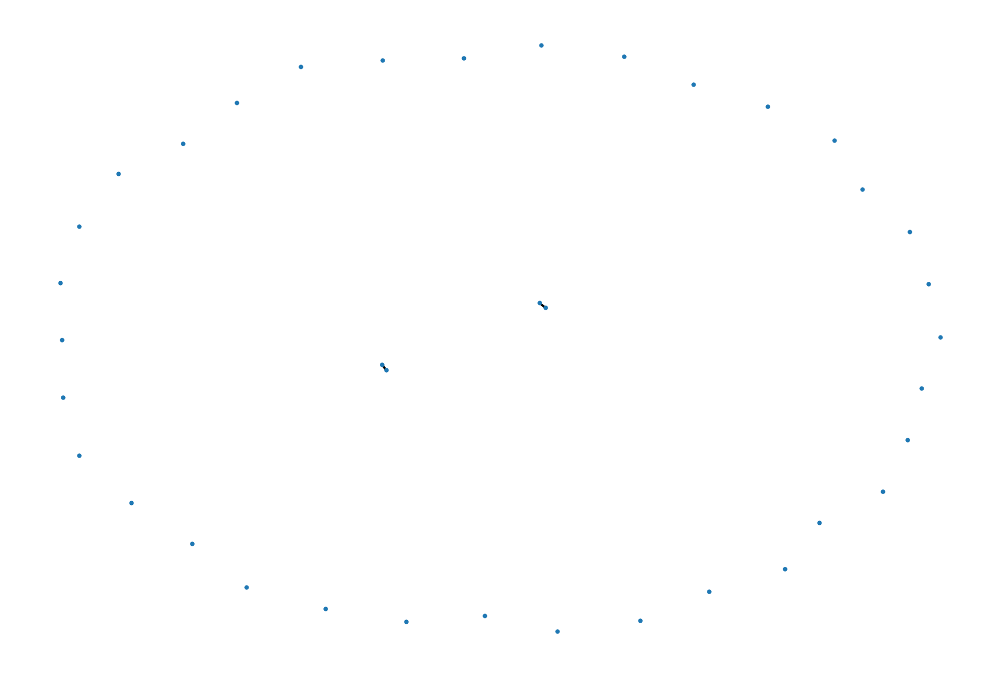

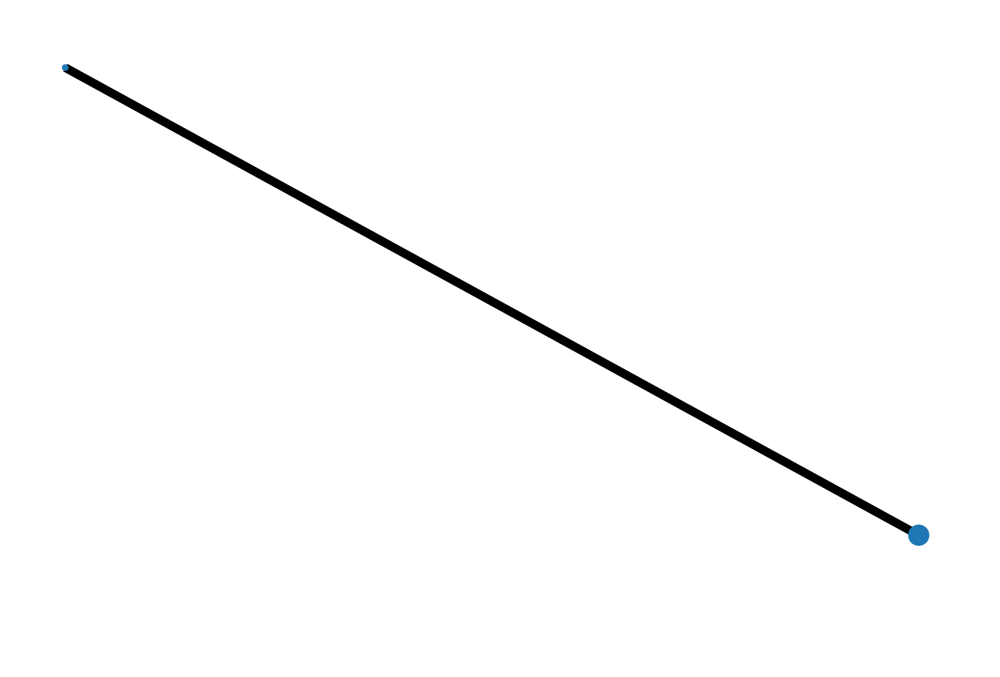

In [71]:
H = G.subgraph(next(nx.connected_components(BM)))
# Makes life easier to have consecutively labeled integer nodes
H = nx.convert_node_labels_to_integers(H)
# Create parititions with hierarchical clustering
partitions = create_hc(H)
# Build blockmodel graph
BM = nx.quotient_graph(H, partitions, relabel=True)

# Draw original graph
pos = nx.spring_layout(H, iterations=150)
# plt.subplot(211)
nx.draw(H, pos, with_labels=False, node_size=1)
plt.show()
plt.close()
# Draw block model with weighted edges and nodes sized by number of internal nodes
node_size = [BM.nodes[x]['nnodes'] * 2 for x in BM.nodes()]
edge_width = [(2 * d['weight']) for (u, v, d) in BM.edges(data=True)]
# Set positions to mean of positions of internal nodes from original graph
posBM = {}
for n in BM:
    xy = numpy.array([pos[u] for u in BM.nodes[n]['graph']])
    posBM[n] = xy.mean(axis=0)

nx.draw(BM, posBM, node_size=node_size, width=edge_width, with_labels=False)
plt.axis('off')
plt.show()

In [72]:
BM.nodes()

NodeView((0, 1))

In [14]:
# foo = list(G.degree()).sort(key=lambda x: x[0])
sorted(list(G.degree()), key = lambda x: int(x[1]), reverse=True)[:7]

[(150, 96),
 (1130, 29),
 (989, 25),
 (728, 24),
 (1376, 23),
 (1902, 23),
 (521, 20)]

In [74]:
shortest_paths = nx.shortest_path_length(G)

In [87]:
a , foo = next(shortest_paths)

In [89]:
foo

{1: 0,
 612: 1,
 2566: 1,
 2999: 1,
 586: 1,
 2511: 1,
 1946: 2,
 2182: 2,
 461: 2,
 307: 2,
 3369: 2,
 3492: 2,
 566: 3,
 2084: 3,
 2774: 3,
 2248: 3,
 2253: 3,
 1023: 3,
 2533: 3,
 905: 3,
 2990: 3,
 3193: 3,
 1808: 4,
 140: 4,
 1478: 4,
 1684: 4,
 63: 4,
 2460: 4,
 2955: 4,
 1784: 4,
 1819: 4,
 150: 5,
 1853: 5,
 3439: 5,
 587: 5,
 2462: 5,
 2713: 5,
 3339: 5,
 555: 5,
 703: 5,
 842: 5,
 1022: 5,
 2133: 5,
 2948: 5,
 1040: 5,
 855: 5,
 2026: 5,
 2461: 5,
 2603: 5,
 2720: 5,
 1617: 5,
 1463: 5,
 3326: 5,
 989: 6,
 1376: 6,
 2757: 6,
 1902: 6,
 2334: 6,
 3447: 6,
 1130: 6,
 2200: 6,
 1423: 6,
 681: 6,
 1397: 6,
 3103: 6,
 3140: 6,
 3456: 6,
 1379: 6,
 1266: 6,
 345: 6,
 851: 6,
 924: 6,
 1196: 6,
 1893: 6,
 2167: 6,
 2252: 6,
 2358: 6,
 2598: 6,
 2646: 6,
 293: 6,
 589: 6,
 627: 6,
 897: 6,
 911: 6,
 987: 6,
 1605: 6,
 1791: 6,
 835: 6,
 902: 6,
 1002: 6,
 1016: 6,
 1017: 6,
 1953: 6,
 1956: 6,
 1962: 6,
 2005: 6,
 2033: 6,
 2132: 6,
 3420: 6,
 16: 6,
 198: 6,
 814: 6,
 819: 6,
 940: 

In [112]:
shortest_paths = nx.shortest_path_length(G, weight='weight')
shortest_paths_array = np.empty([len(precomputed_graph), len(precomputed_graph[0])], dtype=float)
iterator_true = True
while iterator_true:
    
    try:
        node_a, dict_a = next(shortest_paths)
        for node_b, value in dict_a.items():
            shortest_paths_array[node_a, node_b] = value
    except:
        iterator_true = False

In [122]:
di_graph = nx.convert_matrix.from_numpy_array(precomputed_graph, create_using=nx.DiGraph)

In [123]:
import networkx as nx
from networkx.algorithms import community
# G = nx.barbell_graph(5, 1)

communities_generator = community.girvan_newman(di_graph)
top_level_communities = next(communities_generator)
next_level_communities = next(communities_generator)
sorted(map(sorted, next_level_communities))

KeyboardInterrupt: 

In [23]:
backup_graph = G

In [119]:
G = backup_graph

In [5]:
from sklearn.neighbors import NearestNeighbors

In [16]:
node_set = list(nx.nodes(G))

In [17]:
len(node_set)

3494

In [43]:
ordered_nodes = {}
inverse_index_nodes = {}
node_set = list(nx.nodes(G))
length_new_set = 0
length_old_set = len(node_set)
count = 0
while count == 0 and len(node_set) > 1 and length_new_set != length_old_set:
# get degree of neighbor nodes
    degree_of_nodes = G.degree()
    order_of_nodes = []
    degree_one = []
    print('iteration {}'.format(count))
    count += 1
    for key, value in dict(degree_of_nodes).items():
    #     print('{}::{}'.format(key, value))
        if value == 1:
            degree_one.append((key, value))

    dict_conflict_nodes = {}
    nodes_to_remove = []
    for key, value in degree_one:
    #     print()
    #     print('{}::{}'.format(key, value))

    #     print(G.edges(key))
    #     print(list(G.edges(key))[0][1])
        list_nodes = []
        next_node = True
        search_key = key
#         print('key {}'.format(key))
        nodes_visited = []
        old_key = -1
        while next_node:
#             old_key = search_key
            nodes_visited.append(search_key)
            list_neighbors = list(G.edges(search_key))
            print('old_key {} key {} search_key {} list neighbors{} len {}'.format(old_key, key, search_key, list_neighbors, len(list_neighbors)))
            if len(list_neighbors) == 1:
                old_key = search_key
                search_key = list_neighbors[0][1]
                list_nodes.append(search_key)
                
            elif len(list_neighbors) == 2:
                old_key = search_key
                
                list_nodes.append(search_key)
                
                for neighbor in list_neighbors:
                    if neighbor[1] not in list_nodes and neighbor[1] not in nodes_visited:
                        print('search_key {}'.format(old_key))
                        print(list(G.edges(search_key)))
                        search_key = neighbor[1]
                        
                if search_key == old_key:
#                         old_key = search_key
                    next_node = False
                    if search_key in dict_conflict_nodes:
                        dict_conflict_nodes[search_key].append(list_nodes)
                    else:
                        dict_conflict_nodes[search_key] = [list_nodes]
                    for node_list in list_nodes:
                        if node_list in inverse_index_nodes:
                            inverse_index_nodes[node_list].append(search_key)
                        else:
                            inverse_index_nodes[node_list] = [search_key]
            elif len(list_neighbors) > 2:
                next_node = False
                if search_key in dict_conflict_nodes:
                    dict_conflict_nodes[search_key].append(list_nodes)
                else:
                    dict_conflict_nodes[search_key] = [list_nodes]
                for node_list in list_nodes:
                    if node_list in inverse_index_nodes:
                        inverse_index_nodes[node_list].append(search_key)
                    else:
                        inverse_index_nodes[node_list] = [search_key]
#             old_key = search_key
            
    #     print('Key {} Edge {} Degree {}'.format(key,G.edges(key), G.degree(list(G.edges(key))[0][1]) ))
    # print(dict_conflict_nodes)
    
#     length_old_set = len(list(nx.nodes(G)))
#     for key, value in dict_conflict_nodes.items():
#         nodes_list = [item for sublist in value for item in sublist]
#         if len(nodes_list) == 0:
#             continue
#     #     nodes_list.append(key)
#         matrix_minhash = precomputed_graph[nodes_list, :]
#         nbrs = NearestNeighbors(n_neighbors=len(nodes_list)).fit(matrix_minhash)
#     #     print()
#         distances, indices = nbrs.kneighbors([list(precomputed_graph[key, :])])
#         ordered_nodes[key] = np.array(nodes_list)[indices[0]]
#         for node in ordered_nodes[key]:
#             try:
#                 G.remove_node(node)
#             except:
#                 print('Node not in graph : {}'.format(node))
#     node_set = list(nx.nodes(G))
#     length_new_set = len(list(nx.nodes(G)))
    
    

iteration 0
old_key -1 key 3 search_key 3 list neighbors[(3, 2203)] len 1
old_key 3 key 3 search_key 2203 list neighbors[(2203, 1718), (2203, 2558), (2203, 3), (2203, 2525)] len 4
old_key -1 key 4 search_key 4 list neighbors[(4, 1231)] len 1
old_key 4 key 4 search_key 1231 list neighbors[(1231, 632), (1231, 1189), (1231, 4), (1231, 446), (1231, 1197), (1231, 3383)] len 6
old_key -1 key 6 search_key 6 list neighbors[(6, 716)] len 1
old_key 6 key 6 search_key 716 list neighbors[(716, 3066), (716, 6), (716, 3282)] len 3
old_key -1 key 13 search_key 13 list neighbors[(13, 475)] len 1
old_key 13 key 13 search_key 475 list neighbors[(475, 359), (475, 13), (475, 756)] len 3
old_key -1 key 18 search_key 18 list neighbors[(18, 953)] len 1
old_key 18 key 18 search_key 953 list neighbors[(953, 1086), (953, 1437), (953, 398), (953, 2289), (953, 18), (953, 84)] len 6
old_key -1 key 28 search_key 28 list neighbors[(28, 139)] len 1
old_key 28 key 28 search_key 139 list neighbors[(139, 2041), (139, 28

search_key 167
[(167, 570), (167, 1732)]
old_key 167 key 1732 search_key 570 list neighbors[(570, 3447), (570, 167)] len 2
search_key 570
[(570, 3447), (570, 167)]
old_key 570 key 1732 search_key 3447 list neighbors[(3447, 150), (3447, 570), (3447, 172), (3447, 200), (3447, 1772), (3447, 749), (3447, 948), (3447, 2193), (3447, 588), (3447, 1241)] len 10
old_key -1 key 1734 search_key 1734 list neighbors[(1734, 1239)] len 1
old_key 1734 key 1734 search_key 1239 list neighbors[(1239, 1885), (1239, 1734), (1239, 1884)] len 3
old_key -1 key 1738 search_key 1738 list neighbors[(1738, 1723)] len 1
old_key 1738 key 1738 search_key 1723 list neighbors[(1723, 1376), (1723, 995), (1723, 1738), (1723, 931), (1723, 1488)] len 5
old_key -1 key 1739 search_key 1739 list neighbors[(1739, 490)] len 1
old_key 1739 key 1739 search_key 490 list neighbors[(490, 1255), (490, 1730), (490, 2158), (490, 2608), (490, 1739), (490, 2274)] len 6
old_key -1 key 1741 search_key 1741 list neighbors[(1741, 2542)] len

old_key 2534 key 2626 search_key 2005 list neighbors[(2005, 150), (2005, 2534)] len 2
search_key 2005
[(2005, 150), (2005, 2534)]
old_key 2005 key 2626 search_key 150 list neighbors[(150, 989), (150, 1376), (150, 2757), (150, 1902), (150, 1808), (150, 2334), (150, 3447), (150, 1130), (150, 2200), (150, 1423), (150, 681), (150, 1397), (150, 3103), (150, 3140), (150, 3456), (150, 1379), (150, 1266), (150, 345), (150, 851), (150, 924), (150, 1196), (150, 1893), (150, 2167), (150, 2252), (150, 2358), (150, 2598), (150, 2646), (150, 293), (150, 589), (150, 627), (150, 897), (150, 911), (150, 987), (150, 1605), (150, 1791), (150, 835), (150, 902), (150, 1002), (150, 1016), (150, 1017), (150, 1953), (150, 1956), (150, 1962), (150, 2005), (150, 2033), (150, 2132), (150, 3420), (150, 16), (150, 198), (150, 814), (150, 819), (150, 940), (150, 1047), (150, 1296), (150, 1720), (150, 1913), (150, 1978), (150, 1985), (150, 2018), (150, 2170), (150, 2288), (150, 2426), (150, 2433), (150, 2446), (150,

old_key 3231 key 3255 search_key 1161 list neighbors[(1161, 2149), (1161, 3231), (1161, 2316)] len 3
old_key -1 key 3256 search_key 3256 list neighbors[(3256, 247)] len 1
old_key 3256 key 3256 search_key 247 list neighbors[(247, 531), (247, 3256)] len 2
search_key 247
[(247, 531), (247, 3256)]
old_key 247 key 3256 search_key 531 list neighbors[(531, 695), (531, 672), (531, 2263), (531, 247), (531, 450), (531, 778), (531, 65)] len 7
old_key -1 key 3257 search_key 3257 list neighbors[(3257, 1631)] len 1
old_key 3257 key 3257 search_key 1631 list neighbors[(1631, 1769), (1631, 3257)] len 2
search_key 1631
[(1631, 1769), (1631, 3257)]
old_key 1631 key 3257 search_key 1769 list neighbors[(1769, 2903), (1769, 1631), (1769, 30), (1769, 1154)] len 4
old_key -1 key 3258 search_key 3258 list neighbors[(3258, 866)] len 1
old_key 3258 key 3258 search_key 866 list neighbors[(866, 1158), (866, 1240), (866, 1376), (866, 1845), (866, 3258), (866, 1625)] len 6
old_key -1 key 3259 search_key 3259 list n

In [109]:


#     print(nodes_list)
    

In [44]:
len(ordered_nodes)

0

In [45]:
inverse_index_nodes

{2203: [2203, 2203],
 1231: [1231, 1231, 1231, 1231],
 716: [716, 716],
 475: [475, 475],
 953: [953, 953, 953],
 139: [2041, 2041],
 74: [74, 74],
 20: [20],
 2305: [690, 690],
 299: [299],
 2438: [2438, 2438],
 968: [968, 968, 968],
 76: [76, 76, 76, 76],
 3163: [3163, 3163],
 274: [274, 274, 274, 274],
 2281: [2281, 2281],
 328: [328, 328],
 2324: [2324, 2324, 2324, 2324, 2324, 2324],
 2516: [1403, 1403],
 543: [543],
 1096: [1618, 1618],
 1567: [1642, 1642],
 2352: [961, 961],
 120: [120, 120],
 642: [470, 470],
 43: [43, 43, 43],
 681: [681, 681],
 1948: [74, 74],
 916: [916, 916, 916],
 191: [191, 191, 191, 191, 191, 191, 191, 191, 191],
 513: [513, 513],
 902: [902, 902],
 698: [1646, 1646],
 722: [722, 722],
 954: [954, 954],
 89: [89, 89, 89],
 86: [86],
 1130: [1130,
  1130,
  1130,
  1130,
  1130,
  1130,
  1130,
  1130,
  1130,
  1130,
  1130,
  1130,
  1130,
  1130,
  1130],
 1158: [1158, 1158, 1158],
 2132: [2132, 2132],
 740: [740, 740, 740, 740],
 944: [944, 944],
 2200

In [12]:
ordered_nodes

{2203: array([2525,    3]),
 1231: array([1189]),
 716: array([3282,    6]),
 475: array([ 13, 756]),
 953: array([84]),
 74: array([  31, 3108]),
 423: array([1512]),
 299: array([27, 32]),
 2438: array([  46, 1983]),
 968: array([244]),
 76: array([1031, 2268, 1612,   49]),
 3163: array([2570,   53]),
 274: array([2120,   57,  253, 1644]),
 2281: array([970,  59]),
 328: array([393,  62]),
 2324: array([ 823, 2444,  833,   77,  926, 3234]),
 543: array([2559]),
 120: array([623]),
 43: array([2819]),
 681: array([563]),
 916: array([489]),
 191: array([2686]),
 513: array([105, 894]),
 902: array([ 109, 2875]),
 722: array([2827,  116]),
 954: array([2102,  121]),
 89: array([3314, 1039,  127]),
 86: array([89]),
 525: array([133, 250]),
 1130: array([1610]),
 1158: array([1138, 1870, 1693,  138]),
 2132: array([3238,  141]),
 740: array([3192,  779, 3325,  144]),
 944: array([ 146, 3091]),
 2200: array([951]),
 1379: array([1824]),
 3420: array([213, 157]),
 519: array([565, 169]),


In [13]:
ordered_list = []
index = list(ordered_nodes.keys())[0]
end_reached = False
while not end_reached:
    ordered_list.extend(ordered_nodes[index])
    if index in inverse_index_nodes:
        if index == inverse_index_nodes[index][0]:
            print('Dead end {} {}'.format(index, inverse_index_nodes[index]))
            end_reached=True
        else:
            index = inverse_index_nodes[index][0]
    else:
        end_reached=True
    

In [14]:
ordered_list

[2525,
 3,
 1621,
 2203,
 38,
 378,
 1254,
 204,
 150,
 2243,
 1376,
 1117,
 830,
 1417,
 1220,
 1358,
 3403,
 327,
 741]